In [69]:
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import matplotlib as mpl
import anndata as ad
import matplotlib.patheffects as pe
import warnings
from scipy import sparse
import pickle

In [2]:
from tqdm import tqdm

In [70]:
new_rc_params = {'text.usetex': False,
"svg.fonttype": 'none'
}
mpl.rcParams.update(new_rc_params)
plt.rcParams.update({'axes.labelsize' : 16}) 

In [3]:
biological_types = ["1_W3L1",
                    "2_W3D1",
                    "3_F-mini-ON",
                    "4_F-mini-OFF",
                    "5_J-RGC",
                    "6_W3B",
                    "7_Novel",
                    "8_Novel",
                    "9_Tbr1-Novel",
                    "10_ooDSGC",
                    "11_Novel",
                    "12_N-ooDSGC",
                    "13_W3L2",
                    "14_Novel",
                    "15_Novel",
                    "16_D/V-ooDSGC",
                    "17_Tbr1-S1",
                    "18_Novel",
                    "19_Novel",
                    "20_Novel",
                    "21_Tbr1-S2",
                    "22_MX",
                    "23_W3D2",
                    "24_ooDSGC",
                    "25_Novel",
                    "26_Novel",
                    "27_Novel",
                    "28_F-midi-OFF",
                    "29_Novel",
                    "30_W3D3",
                    "31_M2",
                    "32_F-Novel",
                    "33_M1",
                    "34_Novel",
                    "35_Novel",
                    "36_Novel",
                    "37_Novel",
                    "38_F-midi-ON",
                    "39_Novel",
                    "40_M1-duplicate",
                    "41_alphaON-T",
                    "42_alphaOFF-S",
                    "43_alphaON-S/M4",
                    "44_Novel",
                    "45_alphaOFF-T"
]

In [4]:
p5_adata = sc.read_h5ad('adatas/P5_adata_typed.h5ad')
p7_adata = sc.read_h5ad('adatas/P7_adata_pruned.h5ad')
p56_adata = sc.read_h5ad('adatas/P56_adata.h5ad')

In [5]:
p7b2_adata = sc.read_h5ad('adatas/P7b2_adata_pruned.h5ad')

In [6]:
p56_adata.obs['P56_type'] = p56_adata.obs['Bio_type_cluster']

In [7]:
p7_p5_p56_combined_adata = ad.AnnData.concatenate(p7_adata, p7b2_adata, p5_adata, p56_adata, batch_key='Atlas', batch_categories=['P7','P7b2','P5','P56'])

C:\Users\pomat\AppData\Local\Programs\Python\Python311\Lib\site-packages\anndata\_core\anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


# Calculating Global LFCs

In [8]:
p5_adata_raw = p5_adata.raw
p7_adata_raw = p7_adata.raw
p56_adata_raw = p56_adata.raw

In [9]:
p7b2_adata_raw = p7b2_adata.raw

In [10]:
common_genes = []
for i in list(p5_adata_raw.var_names):
    if (i in p7_adata_raw.var_names) & (i in p56_adata_raw.var_names):
        common_genes.append(i)

In [11]:
p5_adata_slice = p5_adata_raw[:, common_genes]
p7_adata_slice = p7_adata_raw[:, common_genes]
p56_adata_slice = p56_adata_raw[:, common_genes]

In [12]:
p7b2_adata_slice = p7b2_adata_raw[:, common_genes]

In [13]:
p5_log_gem = p5_adata_slice.X
p7_log_gem = p7_adata_slice.X
p56_log_gem = p56_adata_slice.X

In [14]:
p7b2_log_gem = p7b2_adata_slice.X

In [15]:
p5_gem = p5_log_gem.expm1()
p7_gem = p7_log_gem.expm1()
p56_gem = p56_log_gem.expm1()

In [16]:
p7b2_gem = p7b2_log_gem.expm1()

In [17]:
p5_mean_exp = p5_gem.mean(0)
p7_mean_exp = p7_gem.mean(0)
p56_mean_exp = p56_gem.mean(0)

In [18]:
p7b2_mean_exp = p7b2_gem.mean(0)

In [19]:
p7_count = p7_adata_slice.X.shape[0]
p7b2_count = p7b2_adata_slice.X.shape[0]
p56_count = p56_adata_slice.X.shape[0]
p5_count = p5_adata_slice.X.shape[0]

p7_raw_X = p7_adata_slice.X
p7_raw_X.eliminate_zeros()
p7_raw_X_trans = p7_raw_X.transpose().tocsr()
p7_cell_counts = p7_raw_X_trans.indptr[1:] - p7_raw_X_trans.indptr[:-1]

p7b2_raw_X = p7b2_adata_slice.X
p7b2_raw_X.eliminate_zeros()
p7b2_raw_X_trans = p7b2_raw_X.transpose().tocsr()
p7b2_cell_counts = p7b2_raw_X_trans.indptr[1:] - p7b2_raw_X_trans.indptr[:-1]

p56_raw_X = p56_adata_slice.X
p56_raw_X.eliminate_zeros()
p56_raw_X_trans = p56_raw_X.transpose().tocsr()
p56_cell_counts = p56_raw_X_trans.indptr[1:] - p56_raw_X_trans.indptr[:-1]

p5_raw_X = p5_adata_slice.X
p5_raw_X.eliminate_zeros()
p5_raw_X_trans = p5_raw_X.transpose().tocsr()
p5_cell_counts = p5_raw_X_trans.indptr[1:] - p5_raw_X_trans.indptr[:-1]

p7_cell_pcts = p7_cell_counts/p7_count
p7b2_cell_pcts = p7b2_cell_counts/p7b2_count
p56_cell_pcts = p56_cell_counts/p56_count
p5_cell_pcts = p5_cell_counts/p5_count

In [20]:
gene_names = []
p7_p5_fold_changes = []
p7_p56_fold_changes = []
p56_p5_fold_changes = []
p56_p7_fold_changes = []
p7b2_p7_fold_changes = []
p7b2_p56_fold_changes = []
p7b2_p5_fold_changes = []
p7_p7b2_fold_changes = []
for i in range(p5_mean_exp.shape[1]):
    gene_name = list(p5_adata_slice.var_names)[i]
    
    p5_index = i
    p7_index = list(p7_adata_slice.var_names).index(gene_name)
    p56_index = list(p56_adata_slice.var_names).index(gene_name)
    
    gene_names.append(gene_name)
    p7_p5_fold_change = (p7_mean_exp[0, p7_index]+0.01)/(p5_mean_exp[0, p5_index]+0.01)
    p7_p5_fold_changes.append(p7_p5_fold_change)
    p7_p56_fold_change = (p7_mean_exp[0, p7_index]+0.01)/(p56_mean_exp[0, p56_index]+0.01)
    p7_p56_fold_changes.append(p7_p56_fold_change)
    p56_p7_fold_changes.append(1/p7_p56_fold_change)
    p56_p5_fold_change = (p56_mean_exp[0, p56_index]+0.01)/(p5_mean_exp[0, p5_index]+0.01)
    p56_p5_fold_changes.append(p56_p5_fold_change)
    p7b2_p7_fold_change = (p7b2_mean_exp[0, p7_index]+0.01)/(p7_mean_exp[0, p7_index]+0.01)
    p7b2_p7_fold_changes.append(p7b2_p7_fold_change)
    p7_p7b2_fold_changes.append(1/p7b2_p7_fold_change)
    p7b2_p56_fold_change = (p7b2_mean_exp[0, p7_index]+0.01)/(p56_mean_exp[0, p56_index]+0.01)
    p7b2_p56_fold_changes.append(p7b2_p56_fold_change)
    p7b2_p5_fold_change = (p7b2_mean_exp[0, p7_index]+0.01)/(p5_mean_exp[0, p5_index]+0.01)
    p7b2_p5_fold_changes.append(p7b2_p5_fold_change)

In [21]:
pickle.dump(p7_p5_fold_changes, open('p7_p5_fold_changes.pkl', 'wb'))
pickle.dump(p7_p56_fold_changes, open('p7_p56_fold_changes.pkl', 'wb'))
pickle.dump(p56_p5_fold_changes, open('p56_p5_fold_changes.pkl', 'wb'))
pickle.dump(p56_p7_fold_changes, open('p56_p7_fold_changes.pkl', 'wb'))
pickle.dump(p7b2_p7_fold_changes, open('p7b2_p7_fold_changes.pkl', 'wb'))
pickle.dump(p7b2_p56_fold_changes, open('p7b2_p56_fold_changes.pkl', 'wb'))
pickle.dump(p7b2_p5_fold_changes, open('p7b2_p5_fold_changes.pkl', 'wb'))
pickle.dump(p7_p7b2_fold_changes, open('p7_p7b2_fold_changes.pkl', 'wb'))

In [22]:
p7_p5_blacklist = []
p7_p56_blacklist = []
p7_p7b2_blacklist = []
p5_p56_blacklist = []
p5_p7b2_blacklist = []
p56_p7b2_blacklist = []
for i in range(p5_mean_exp.shape[1]):
    gene_name = list(p5_adata_slice.var_names)[i]
    
    p5_index = i
    p7_index = list(p7_adata_slice.var_names).index(gene_name)
    p56_index = list(p56_adata_slice.var_names).index(gene_name)

    if p7_cell_pcts[p7_index] < 0.05:
        if p5_cell_pcts[p5_index] < 0.05:
            p7_p5_blacklist.append(i)
        if p56_cell_pcts[p56_index] < 0.05:
            p7_p56_blacklist.append(i)
        if p7b2_cell_pcts[p7_index] < 0.05:
            p7_p7b2_blacklist.append(i)
    if p5_cell_pcts[p5_index] < 0.05:
        if p56_cell_pcts[p56_index] < 0.05:
            p5_p56_blacklist.append(i)
        if p7b2_cell_pcts[p7_index] < 0.05:
            p5_p7b2_blacklist.append(i)
    if p56_cell_pcts[p56_index] < 0.05:
        if p7b2_cell_pcts[p7_index] < 0.05:
            p56_p7b2_blacklist.append(i)

In [23]:
pickle.dump(p7_p5_blacklist, open('p7_p5_blacklist.pkl', 'wb'))
pickle.dump(p7_p56_blacklist, open('p7_p56_blacklist.pkl', 'wb'))
pickle.dump(p7_p7b2_blacklist, open('p7_p7b2_blacklist.pkl', 'wb'))
pickle.dump(p5_p56_blacklist, open('p5_p56_blacklist.pkl', 'wb'))
pickle.dump(p5_p7b2_blacklist, open('p5_p7b2_blacklist.pkl', 'wb'))
pickle.dump(p56_p7b2_blacklist, open('p56_p7b2_blacklist.pkl', 'wb'))

In [37]:
p7_combined_adata = ad.concat([p7_adata, p7b2_adata], label='Condition', keys=['WT', 'β2-KO'])

C:\Users\pomat\AppData\Local\Programs\Python\Python311\Lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [38]:
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.tl.rank_genes_groups(p7_combined_adata, 'Condition', method='wilcoxon')

In [39]:
de_genes = sc.get.rank_genes_groups_df(p7_combined_adata, 'WT', pval_cutoff=0.05).sort_values('logfoldchanges', ascending=False)

In [40]:
p7_p7b2_blacklist_names = [gene_names[i] for i in p7_p7b2_blacklist]

In [41]:
p7_adata_raw_2 = p7_adata.raw
p7b2_adata_raw_2 = p7b2_adata.raw

p7_count_2 = p7_adata_raw_2.X.shape[0]
p7b2_count_2 = p7b2_adata_raw_2.X.shape[0]

p7_raw_X_2 = p7_adata.raw.X
p7_raw_X_2.eliminate_zeros()
p7_raw_X_trans_2 = p7_raw_X_2.transpose().tocsr()
p7_cell_counts_2 = p7_raw_X_trans_2.indptr[1:] - p7_raw_X_trans_2.indptr[:-1]

p7b2_raw_X_2 = p7b2_adata.raw.X
p7b2_raw_X_2.eliminate_zeros()
p7b2_raw_X_trans_2 = p7b2_raw_X_2.transpose().tocsr()
p7b2_cell_counts_2 = p7b2_raw_X_trans_2.indptr[1:] - p7b2_raw_X_trans_2.indptr[:-1]

p7_cell_pcts_2 = p7_cell_counts_2/p7_count_2
p7b2_cell_pcts_2 = p7b2_cell_counts_2/p7b2_count_2

In [42]:
p7_p7b2_blacklist_2 = []
p7_p7b2_blacklist_genes_2 = []
for i in range(len(p7_adata_raw_2.var_names)):
    if (p7_cell_pcts_2[i] < 0.05) and (p7_cell_pcts_2[i] < 0.05):
        p7_p7b2_blacklist_2.append(i)
        p7_p7b2_blacklist_genes_2.append(p7_adata_raw_2.var_names[i])

In [43]:
de_genes_filtered = de_genes[~de_genes['names'].isin(p7_p7b2_blacklist_genes_2)]

# Calculating Inter-Replicate LFCs

In [31]:
p7rep1_adata_raw = p7_adata[p7_adata.obs["Batch"] == "Batch1"].raw
p7rep2_adata_raw = p7_adata[p7_adata.obs["Batch"] == "Batch2"].raw
p7rep3_adata_raw = p7_adata[p7_adata.obs["Batch"] == "Batch3"].raw

In [32]:
p7b2rep1_adata_raw = p7b2_adata[p7b2_adata.obs["Batch"].isin(["Batch1", "Batch2"])].raw
p7b2rep2_adata_raw = p7b2_adata[p7b2_adata.obs["Batch"] == "Batch1_2"].raw
p7b2rep3_adata_raw = p7b2_adata[p7b2_adata.obs["Batch"] == "Batch2_2"].raw

In [33]:
p7rep1_adata_slice = p7rep1_adata_raw[:, common_genes]
p7rep2_adata_slice = p7rep2_adata_raw[:, common_genes]
p7rep3_adata_slice = p7rep3_adata_raw[:, common_genes]

In [34]:
p7b2rep1_adata_slice = p7b2rep1_adata_raw[:, common_genes]
p7b2rep2_adata_slice = p7b2rep2_adata_raw[:, common_genes]
p7b2rep3_adata_slice = p7b2rep3_adata_raw[:, common_genes]

In [35]:
p7rep1_log_gem = p7rep1_adata_slice.X
p7rep2_log_gem = p7rep2_adata_slice.X
p7rep3_log_gem = p7rep3_adata_slice.X

In [36]:
p7b2rep1_log_gem = p7b2rep1_adata_slice.X
p7b2rep2_log_gem = p7b2rep2_adata_slice.X
p7b2rep3_log_gem = p7b2rep3_adata_slice.X

In [37]:
p7rep1_gem = p7rep1_log_gem.expm1()
p7rep2_gem = p7rep2_log_gem.expm1()
p7rep3_gem = p7rep3_log_gem.expm1()

In [38]:
p7b2rep1_gem = p7b2rep1_log_gem.expm1()
p7b2rep2_gem = p7b2rep2_log_gem.expm1()
p7b2rep3_gem = p7b2rep3_log_gem.expm1()

In [39]:
p7rep1_mean_exp = p7rep1_gem.mean(0)
p7rep2_mean_exp = p7rep2_gem.mean(0)
p7rep3_mean_exp = p7rep3_gem.mean(0)

In [40]:
p7b2rep1_mean_exp = p7b2rep1_gem.mean(0)
p7b2rep2_mean_exp = p7b2rep2_gem.mean(0)
p7b2rep3_mean_exp = p7b2rep3_gem.mean(0)

In [41]:
p7rep1_count = p7rep1_adata_slice.X.shape[0]
p7rep2_count = p7rep2_adata_slice.X.shape[0]
p7rep3_count = p7rep3_adata_slice.X.shape[0]
p7b2rep1_count = p7b2rep1_adata_slice.X.shape[0]
p7b2rep2_count = p7b2rep2_adata_slice.X.shape[0]
p7b2rep3_count = p7b2rep3_adata_slice.X.shape[0]

p7rep1_raw_X = p7rep1_adata_slice.X
p7rep1_raw_X.eliminate_zeros()
p7rep1_raw_X_trans = p7rep1_raw_X.transpose().tocsr()
p7rep1_cell_counts = p7rep1_raw_X_trans.indptr[1:] - p7rep1_raw_X_trans.indptr[:-1]

p7rep2_raw_X = p7rep2_adata_slice.X
p7rep2_raw_X.eliminate_zeros()
p7rep2_raw_X_trans = p7rep2_raw_X.transpose().tocsr()
p7rep2_cell_counts = p7rep2_raw_X_trans.indptr[1:] - p7rep2_raw_X_trans.indptr[:-1]

p7rep3_raw_X = p7rep3_adata_slice.X
p7rep3_raw_X.eliminate_zeros()
p7rep3_raw_X_trans = p7rep3_raw_X.transpose().tocsr()
p7rep3_cell_counts = p7rep3_raw_X_trans.indptr[1:] - p7rep3_raw_X_trans.indptr[:-1]

p7b2rep1_raw_X = p7b2rep1_adata_slice.X
p7b2rep1_raw_X.eliminate_zeros()
p7b2rep1_raw_X_trans = p7b2rep1_raw_X.transpose().tocsr()
p7b2rep1_cell_counts = p7b2rep1_raw_X_trans.indptr[1:] - p7b2rep1_raw_X_trans.indptr[:-1]

p7b2rep2_raw_X = p7b2rep2_adata_slice.X
p7b2rep2_raw_X.eliminate_zeros()
p7b2rep2_raw_X_trans = p7b2rep2_raw_X.transpose().tocsr()
p7b2rep2_cell_counts = p7b2rep2_raw_X_trans.indptr[1:] - p7b2rep2_raw_X_trans.indptr[:-1]

p7b2rep3_raw_X = p7b2rep3_adata_slice.X
p7b2rep3_raw_X.eliminate_zeros()
p7b2rep3_raw_X_trans = p7b2rep3_raw_X.transpose().tocsr()
p7b2rep3_cell_counts = p7b2rep3_raw_X_trans.indptr[1:] - p7b2rep3_raw_X_trans.indptr[:-1]

p7rep1_cell_pcts = p7rep1_cell_counts/p7rep1_count
p7rep2_cell_pcts = p7rep2_cell_counts/p7rep2_count
p7rep3_cell_pcts = p7rep3_cell_counts/p7rep3_count
p7b2rep1_cell_pcts = p7b2rep1_cell_counts/p7b2rep1_count
p7b2rep2_cell_pcts = p7b2rep2_cell_counts/p7b2rep2_count
p7b2rep3_cell_pcts = p7b2rep3_cell_counts/p7b2rep3_count

In [42]:
gene_names = []
p7rep1_p7rep2_fold_changes = []
p7rep1_p7rep3_fold_changes = []
p7rep2_p7rep3_fold_changes = []
p7b2rep1_p7b2rep2_fold_changes = []
p7b2rep1_p7b2rep3_fold_changes = []
p7b2rep2_p7b2rep3_fold_changes = []
for i in range(p5_mean_exp.shape[1]):
    gene_name = list(p5_adata_slice.var_names)[i]
    p7_index = list(p7_adata_slice.var_names).index(gene_name)
    
    #if (p5_mean_exp[0, p5_index] != 0) & (p7_mean_exp[0, p7_index] != 0) & (p56_mean_exp[0, p56_index] != 0) & (p7Batch2_mean_exp[0, p7_index] != 0) & (p7Batch3_mean_exp[0, p7_index] != 0) & (p5Batch3_mean_exp[0, p5_index] != 0) & (p5Batch5_mean_exp[0, p5_index] != 0):
    gene_names.append(gene_name)
    p7rep1_p7rep2_fold_change = (p7rep1_mean_exp[0, p7_index]+0.01)/(p7rep2_mean_exp[0, p7_index]+0.01)
    p7rep1_p7rep2_fold_changes.append(p7rep1_p7rep2_fold_change)
    p7rep1_p7rep3_fold_change = (p7rep1_mean_exp[0, p7_index]+0.01)/(p7rep3_mean_exp[0, p7_index]+0.01)
    p7rep1_p7rep3_fold_changes.append(p7rep1_p7rep3_fold_change)
    p7rep2_p7rep3_fold_change = (p7rep2_mean_exp[0, p7_index]+0.01)/(p7rep3_mean_exp[0, p7_index]+0.01)
    p7rep2_p7rep3_fold_changes.append(p7rep2_p7rep3_fold_change)

    p7b2rep1_p7b2rep2_fold_change = (p7b2rep1_mean_exp[0, p7_index]+0.01)/(p7b2rep2_mean_exp[0, p7_index]+0.01)
    p7b2rep1_p7b2rep2_fold_changes.append(p7b2rep1_p7b2rep2_fold_change)
    p7b2rep1_p7b2rep3_fold_change = (p7b2rep1_mean_exp[0, p7_index]+0.01)/(p7b2rep3_mean_exp[0, p7_index]+0.01)
    p7b2rep1_p7b2rep3_fold_changes.append(p7b2rep1_p7b2rep3_fold_change)
    p7b2rep2_p7b2rep3_fold_change = (p7b2rep2_mean_exp[0, p7_index]+0.01)/(p7b2rep3_mean_exp[0, p7_index]+0.01)
    p7b2rep2_p7b2rep3_fold_changes.append(p7b2rep2_p7b2rep3_fold_change)

In [43]:
pickle.dump(p7rep1_p7rep2_fold_changes, open('p7rep1_p7rep2_fold_changes.pkl', 'wb'))
pickle.dump(p7rep1_p7rep3_fold_changes, open('p7rep1_p7rep3_fold_changes.pkl', 'wb'))
pickle.dump(p7rep2_p7rep3_fold_changes, open('p7rep2_p7rep3_fold_changes.pkl', 'wb'))
pickle.dump(p7b2rep1_p7b2rep2_fold_changes, open('p7b2rep1_p7b2rep2_fold_changes.pkl', 'wb'))
pickle.dump(p7b2rep1_p7b2rep3_fold_changes, open('p7b2rep1_p7b2rep3_fold_changes.pkl', 'wb'))
pickle.dump(p7b2rep2_p7b2rep3_fold_changes, open('p7b2rep2_p7b2rep3_fold_changes.pkl', 'wb'))

In [44]:
p7rep1_p7rep2_blacklist = []
p7rep1_p7rep3_blacklist = []
p7rep2_p7rep3_blacklist = []
p7b2rep1_p7b2rep2_blacklist = []
p7b2rep1_p7b2rep3_blacklist = []
p7b2rep2_p7b2rep3_blacklist = []
for i in range(p5_mean_exp.shape[1]):
    gene_name = list(p5_adata_slice.var_names)[i]
    p7_index = list(p7_adata_slice.var_names).index(gene_name)

    if p7rep1_cell_pcts[p7_index] < 0.05:
        if p7rep2_cell_pcts[p7_index] < 0.05:
            p7rep1_p7rep2_blacklist.append(i)
        if p7rep3_cell_pcts[p7_index] < 0.05:
            p7rep1_p7rep3_blacklist.append(i)
    if p7rep2_cell_pcts[p7_index] < 0.05:
        if p7rep3_cell_pcts[p7_index] < 0.05:
            p7rep2_p7rep3_blacklist.append(i)
    if p7b2rep1_cell_pcts[p7_index] < 0.05:
        if p7b2rep2_cell_pcts[p7_index] < 0.05:
            p7b2rep1_p7b2rep2_blacklist.append(i)
        if p7b2rep3_cell_pcts[p7_index] < 0.05:
            p7b2rep1_p7b2rep3_blacklist.append(i)
    if p7b2rep2_cell_pcts[p7_index] < 0.05:
        if p7b2rep3_cell_pcts[p7_index] < 0.05:
            p7b2rep2_p7b2rep3_blacklist.append(i)

In [45]:
pickle.dump(p7rep1_p7rep2_blacklist, open('p7rep1_p7rep2_blacklist.pkl', 'wb'))
pickle.dump(p7rep1_p7rep3_blacklist, open('p7rep1_p7rep3_blacklist.pkl', 'wb'))
pickle.dump(p7rep2_p7rep3_blacklist, open('p7rep2_p7rep3_blacklist.pkl', 'wb'))
pickle.dump(p7b2rep1_p7b2rep2_blacklist, open('p7b2rep1_p7b2rep2_blacklist.pkl', 'wb'))
pickle.dump(p7b2rep1_p7b2rep3_blacklist, open('p7b2rep1_p7b2rep3_blacklist.pkl', 'wb'))
pickle.dump(p7b2rep2_p7b2rep3_blacklist, open('p7b2rep2_p7b2rep3_blacklist.pkl', 'wb'))

# By Type

In [24]:
p56_p56_types = []
for i in p56_adata.obs['P56_type']:
    p56_p56_types.append(int(i))
p56_adata.obs['P56_type'] = pd.Categorical(p56_p56_types)

In [25]:
p5_mean_exp_by_type = []
p7_mean_exp_by_type = []
p56_mean_exp_by_type = []
p7b2_mean_exp_by_type = []

p5_cell_pcts_by_type = []
p7_cell_pcts_by_type = []
p56_cell_pcts_by_type = []
p7b2_cell_pcts_by_type = []
for i in biological_types:
    P56_type = int(i.split('_')[0])
    
    p5_adata_raw_type = p5_adata[p5_adata.obs['P56_type'] == P56_type].raw
    p7_adata_raw_type = p7_adata[p7_adata.obs['P56_type'] == P56_type].raw
    p56_adata_raw_type = p56_adata[p56_adata.obs['P56_type'] == P56_type].raw
    p7b2_adata_raw_type = p7b2_adata[p7b2_adata.obs['P56_type'] == P56_type].raw
    
    p5_adata_slice_type = p5_adata_raw_type[:, common_genes]
    p7_adata_slice_type = p7_adata_raw_type[:, common_genes]
    p56_adata_slice_type = p56_adata_raw_type[:, common_genes]
    p7b2_adata_slice_type = p7b2_adata_raw_type[:, common_genes]
    
    p5_log_gem_type = p5_adata_slice_type.X
    p7_log_gem_type = p7_adata_slice_type.X
    p56_log_gem_type = p56_adata_slice_type.X
    p7b2_log_gem_type = p7b2_adata_slice_type.X
    
    p5_gem_type = p5_log_gem_type.expm1()
    p7_gem_type = p7_log_gem_type.expm1()
    p56_gem_type = p56_log_gem_type.expm1()
    p7b2_gem_type = p7b2_log_gem_type.expm1()
    
    p5_mean_exp_type = p5_gem_type.mean(0)
    p7_mean_exp_type = p7_gem_type.mean(0)
    p56_mean_exp_type = p56_gem_type.mean(0)
    p7b2_mean_exp_type = p7b2_gem_type.mean(0)
    
    p5_mean_exp_by_type.append(p5_mean_exp_type)
    p7_mean_exp_by_type.append(p7_mean_exp_type)
    p56_mean_exp_by_type.append(p56_mean_exp_type)
    p7b2_mean_exp_by_type.append(p7b2_mean_exp_type)
    
    p7_count_type = p7_adata_slice_type.X.shape[0]
    p7b2_count_type = p7b2_adata_slice_type.X.shape[0]
    p56_count_type = p56_adata_slice_type.X.shape[0]
    p5_count_type = p5_adata_slice_type.X.shape[0]
    
    p7_raw_X_type = p7_adata_slice_type.X
    p7_raw_X_type.eliminate_zeros()
    p7_raw_X_trans_type = p7_raw_X_type.transpose().tocsr()
    p7_cell_counts_type = p7_raw_X_trans_type.indptr[1:] - p7_raw_X_trans_type.indptr[:-1]
    
    p7b2_raw_X_type = p7b2_adata_slice_type.X
    p7b2_raw_X_type.eliminate_zeros()
    p7b2_raw_X_trans_type = p7b2_raw_X_type.transpose().tocsr()
    p7b2_cell_counts_type = p7b2_raw_X_trans_type.indptr[1:] - p7b2_raw_X_trans_type.indptr[:-1]
    
    p56_raw_X_type = p56_adata_slice_type.X
    p56_raw_X_type.eliminate_zeros()
    p56_raw_X_trans_type = p56_raw_X_type.transpose().tocsr()
    p56_cell_counts_type = p56_raw_X_trans_type.indptr[1:] - p56_raw_X_trans_type.indptr[:-1]
    
    p5_raw_X_type = p5_adata_slice_type.X
    p5_raw_X_type.eliminate_zeros()
    p5_raw_X_trans_type = p5_raw_X_type.transpose().tocsr()
    p5_cell_counts_type = p5_raw_X_trans_type.indptr[1:] - p5_raw_X_trans_type.indptr[:-1]
    
    p7_cell_pcts_type = p7_cell_counts_type/p7_count_type
    p7b2_cell_pcts_type = p7b2_cell_counts_type/p7b2_count_type
    p56_cell_pcts_type = p56_cell_counts_type/p56_count_type
    p5_cell_pcts_type = p5_cell_counts_type/p5_count_type

    p7_cell_pcts_by_type.append(p7_cell_pcts_type)
    p7b2_cell_pcts_by_type.append(p7b2_cell_pcts_type)
    p56_cell_pcts_by_type.append(p56_cell_pcts_type)
    p5_cell_pcts_by_type.append(p5_cell_pcts_type)

    print(P56_type)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45


In [26]:
p7_p5_fold_changes_by_type = []
p7_p56_fold_changes_by_type = []
p56_p5_fold_changes_by_type = []
p56_p7_fold_changes_by_type = []
p7b2_p7_fold_changes_by_type = []
p7b2_p56_fold_changes_by_type = []
p7b2_p5_fold_changes_by_type = []
p7_p7b2_fold_changes_by_type = []
for j in tqdm(range(len(biological_types))):
    p7_p5_fold_changes_type = []
    p7_p56_fold_changes_type = []
    p56_p5_fold_changes_type = []
    p56_p7_fold_changes_type = []
    p7b2_p7_fold_changes_type = []
    p7b2_p56_fold_changes_type = []
    p7b2_p5_fold_changes_type = []
    p7_p7b2_fold_changes_type = []
    for i in range(p5_mean_exp.shape[1]):
        gene_name = list(p5_adata_slice.var_names)[i]
        
        p5_index = i
        p7_index = list(p7_adata_slice.var_names).index(gene_name)
        p56_index = list(p56_adata_slice.var_names).index(gene_name)

        pseudocount = 0.1
        #if (p5_mean_exp[0, p5_index] != 0) & (p7_mean_exp[0, p7_index] != 0) & (p56_mean_exp[0, p56_index] != 0) & (p7Batch2_mean_exp[0, p7_index] != 0) & (p7Batch3_mean_exp[0, p7_index] != 0) & (p5Batch3_mean_exp[0, p5_index] != 0) & (p5Batch5_mean_exp[0, p5_index] != 0):
        # gene_names.append(gene_name)
        p7_p5_fold_change = (p7_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p5_mean_exp_by_type[j][0, p5_index]+pseudocount)
        p7_p5_fold_changes_type.append(p7_p5_fold_change)
        p7_p56_fold_change = (p7_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p56_mean_exp_by_type[j][0, p56_index]+pseudocount)
        p7_p56_fold_changes_type.append(p7_p56_fold_change)
        p56_p7_fold_changes_type.append(1/p7_p56_fold_change)
        p56_p5_fold_change = (p56_mean_exp_by_type[j][0, p56_index]+pseudocount)/(p5_mean_exp_by_type[j][0, p5_index]+pseudocount)
        p56_p5_fold_changes_type.append(p56_p5_fold_change)
        p7b2_p7_fold_change = (p7b2_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p7_mean_exp_by_type[j][0, p7_index]+pseudocount)
        p7b2_p7_fold_changes_type.append(p7b2_p7_fold_change)
        p7_p7b2_fold_changes_type.append(1/p7b2_p7_fold_change)
        p7b2_p56_fold_change = (p7b2_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p56_mean_exp_by_type[j][0, p56_index]+pseudocount)
        p7b2_p56_fold_changes_type.append(p7b2_p56_fold_change)
        p7b2_p5_fold_change = (p7b2_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p5_mean_exp_by_type[j][0, p5_index]+pseudocount)
        p7b2_p5_fold_changes_type.append(p7b2_p5_fold_change)
    p7_p5_fold_changes_by_type.append(p7_p5_fold_changes_type)
    p7_p56_fold_changes_by_type.append(p7_p56_fold_changes_type)
    p56_p5_fold_changes_by_type.append(p56_p5_fold_changes_type)
    p56_p7_fold_changes_by_type.append(p56_p7_fold_changes_type)
    p7b2_p7_fold_changes_by_type.append(p7b2_p7_fold_changes_type)
    p7b2_p56_fold_changes_by_type.append(p7b2_p56_fold_changes_type)
    p7b2_p5_fold_changes_by_type.append(p7b2_p5_fold_changes_type)
    p7_p7b2_fold_changes_by_type.append(p7_p7b2_fold_changes_type)

100%|██████████████████████████████████████████████████████████████████████████████████| 45/45 [20:48<00:00, 27.74s/it]


In [27]:
import pickle

In [46]:
pickle.dump(p7_p5_fold_changes_by_type, open('p7_p5_fold_changes_by_type.pkl', 'wb'))
pickle.dump(p7_p56_fold_changes_by_type, open('p7_p56_fold_changes_by_type.pkl', 'wb'))
pickle.dump(p56_p5_fold_changes_by_type, open('p56_p5_fold_changes_by_type.pkl', 'wb'))
pickle.dump(p56_p7_fold_changes_by_type, open('p56_p7_fold_changes_by_type.pkl', 'wb'))
pickle.dump(p7b2_p7_fold_changes_by_type, open('p7b2_p7_fold_changes_by_type.pkl', 'wb'))
pickle.dump(p7b2_p56_fold_changes_by_type, open('p7b2_p56_fold_changes_by_type.pkl', 'wb'))
pickle.dump(p7b2_p5_fold_changes_by_type, open('p7b2_p5_fold_changes_by_type.pkl', 'wb'))
pickle.dump(p7_p7b2_fold_changes_by_type, open('p7_p7b2_fold_changes_by_type.pkl', 'wb'))

In [29]:
p7_p5_blacklist_by_type = []
p7_p56_blacklist_by_type = []
p7_p7b2_blacklist_by_type = []
p5_p56_blacklist_by_type = []
p5_p7b2_blacklist_by_type = []
p56_p7b2_blacklist_by_type = []
for j in tqdm(range(len(biological_types))):
    p7_num = len(p7_adata[p7_adata.obs['P56_type'] == j].obs)
    p7b2_num = len(p7b2_adata[p7b2_adata.obs['P56_type'] == j].obs)
    p5_num = len(p5_adata[p5_adata.obs['P56_type'] == j].obs)
    p56_num = len(p56_adata[p56_adata.obs['P56_type'] == j].obs)
    # if (p7_num < 40) or (p7b2_num < 40) or (p5_num < 40) or (p56_num < 40):
    #     worldwide_percentage = 0.2
    # else:
    #     worldwide_percentage = 0.05
    p7_p5_blacklist_type = []
    p7_p56_blacklist_type = []
    p7_p7b2_blacklist_type = []
    p5_p56_blacklist_type = []
    p5_p7b2_blacklist_type = []
    p56_p7b2_blacklist_type = []
    for i in range(p5_mean_exp.shape[1]):
        gene_name = list(p5_adata_slice.var_names)[i]
        
        p5_index = i
        p7_index = list(p7_adata_slice.var_names).index(gene_name)
        p56_index = list(p56_adata_slice.var_names).index(gene_name)
    
        if p7_cell_pcts_by_type[j][p7_index] < 0.05:
            if p5_cell_pcts_by_type[j][p5_index] < 0.05:
                p7_p5_blacklist_type.append(i)
            if p56_cell_pcts_by_type[j][p56_index] < 0.05:
                p7_p56_blacklist_type.append(i)
            if p7b2_cell_pcts_by_type[j][p7_index] < 0.05:
                p7_p7b2_blacklist_type.append(i)
        if p5_cell_pcts_by_type[j][p5_index] < 0.05:
            if p56_cell_pcts_by_type[j][p56_index] < 0.05:
                p5_p56_blacklist_type.append(i)
            if p7b2_cell_pcts_by_type[j][p7_index] < 0.05:
                p5_p7b2_blacklist_type.append(i)
        if p56_cell_pcts_by_type[j][p56_index] < 0.05:
            if p7b2_cell_pcts_by_type[j][p7_index] < 0.05:
                p56_p7b2_blacklist_type.append(i)
    p7_p5_blacklist_by_type.append(p7_p5_blacklist_type)
    p7_p56_blacklist_by_type.append(p7_p5_blacklist_type)
    p7_p7b2_blacklist_by_type.append(p7_p5_blacklist_type)
    p5_p56_blacklist_by_type.append(p7_p5_blacklist_type)
    p5_p7b2_blacklist_by_type.append(p7_p5_blacklist_type)
    p56_p7b2_blacklist_by_type.append(p7_p5_blacklist_type)

100%|██████████████████████████████████████████████████████████████████████████████████| 45/45 [20:39<00:00, 27.55s/it]


In [30]:
pickle.dump(p7_p5_blacklist_by_type, open('p7_p5_blacklist_by_type.pkl', 'wb'))
pickle.dump(p7_p56_blacklist_by_type, open('p7_p56_blacklist_by_type.pkl', 'wb'))
pickle.dump(p7_p7b2_blacklist_by_type, open('p7_p7b2_blacklist_by_type.pkl', 'wb'))
pickle.dump(p5_p56_blacklist_by_type, open('p5_p56_blacklist_by_type.pkl', 'wb'))
pickle.dump(p5_p7b2_blacklist_by_type, open('p5_p7b2_blacklist_by_type.pkl', 'wb'))
pickle.dump(p56_p7b2_blacklist_by_type, open('p56_p7b2_blacklist_by_type.pkl', 'wb'))

In [86]:
def make_type_scatter(fold_changes_1, fold_changes_2, blacklists, xlabel, ylabel, figname, DE_genes_up, DE_genes_down):
    #start from top left and move right then down, like reading
    square_counts = [0,0,0,0,0,0,0,0,0]
    for x in tqdm(range(len(fold_changes_1))):
        blacklist = [i for j in blacklists for i in j[x]]
        x_FC = [fold_changes_1[x][i] for i in range(len(fold_changes_1[x])) if i not in blacklist]
        y_FC = [fold_changes_2[x][i] for i in range(len(fold_changes_2[x])) if i not in blacklist]
        
        for i in range(len(x_FC)):
            square_index_1 = 0
            square_index_2 = 0
            if np.log2(y_FC[i]) >= 2:
                square_index_1 = 0
            elif np.log2(y_FC[i]) >= -2:
                square_index_1 = 3
            else:
                square_index_1 = 6
            
            if np.log2(x_FC[i]) <= -2:
                square_index_2 = 0
            elif np.log2(x_FC[i]) <= 2:
                square_index_2 = 1
            else:
                square_index_2 = 2
            
            square_index = square_index_1+square_index_2
            square_counts[square_index] += 1
        
        plt.scatter(np.log2(x_FC), np.log2(y_FC), s=0.2, c='black')
    for x in tqdm(range(len(DE_genes_up))):
        blacklist = [i for j in blacklists for i in j[x]]
        x_FC = []
        y_FC = []
        for i in DE_genes_up[x]:
            gene_index = gene_names.index(i)
            if gene_index not in blacklist:
                x_FC.append(fold_changes_1[x][gene_index])
                y_FC.append(fold_changes_2[x][gene_index])
        
        plt.scatter(np.log2(x_FC), np.log2(y_FC), s=0.2, c='red')
    for x in tqdm(range(len(DE_genes_down))):
        blacklist = [i for j in blacklists for i in j[x]]
        x_FC = []
        y_FC = []
        for i in DE_genes_down[x]:
            gene_index = gene_names.index(i)
            if gene_index not in blacklist:
                x_FC.append(fold_changes_1[x][gene_index])
                y_FC.append(fold_changes_2[x][gene_index])
        
        plt.scatter(np.log2(x_FC), np.log2(y_FC), s=0.2, c='blue')
    plt.xlim(-6,6)
    plt.ylim(-6,6)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.xticks([-6,-4,-2,0,2,4,6])
    ax = plt.gca()
    ax.set_aspect('equal')
    ax.grid(False)
    plt.plot([-2,-2],[-100,100], c='red', linestyle='dashed', linewidth=0.8)
    plt.plot([2,2],[-100,100], c='red', linestyle='dashed', linewidth=0.8)
    plt.plot([-100,100],[-2,-2], c='red', linestyle='dashed', linewidth=0.8)
    plt.plot([-100,100],[2,2], c='red', linestyle='dashed', linewidth=0.8)
    xs = [-5,0,5,-5,0,5,-5,0,5]
    ys = [5,5,5,0,0,0,-5,-5,-5]
    for i in range(len(square_counts)):
        if i != 4:
            x = xs[i]
            y = ys[i]
            label = square_counts[i]
            plt.text(x, y, label, va='center', ha='center', path_effects=[pe.withStroke(linewidth=5, foreground='w')])
    plt.savefig(figname)

9576
9819
9960
9702
10248
10210
10322
10477
10033
10606
10031
10408
10404
10469
10048
10456
10461
10539
9854
9962


C:\Users\pomat\AppData\Local\Temp\ipykernel_30468\1255198397.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


10403
10690
10178
10773
10222
10536
10521
9675
10113
10155
10641
10170
10015
10607
10184
10486
10653
10340
10242
10472
10825
10795
10924
9534


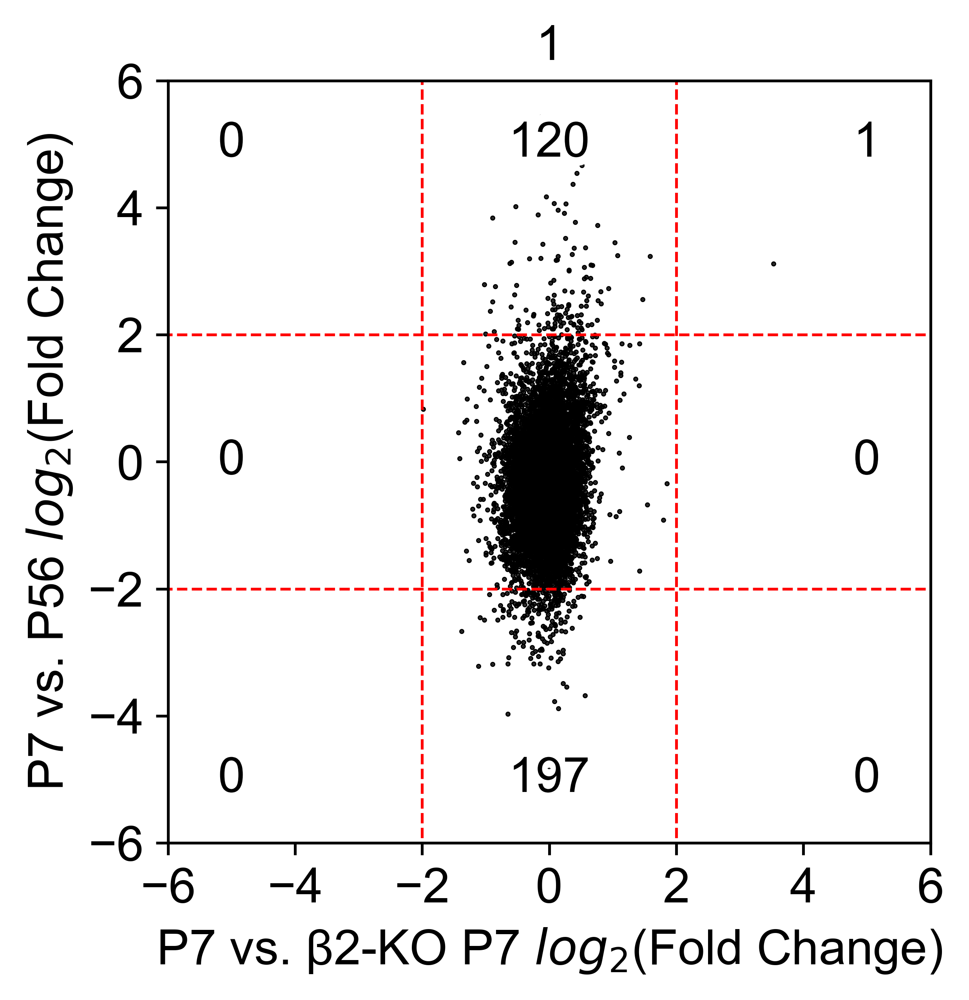

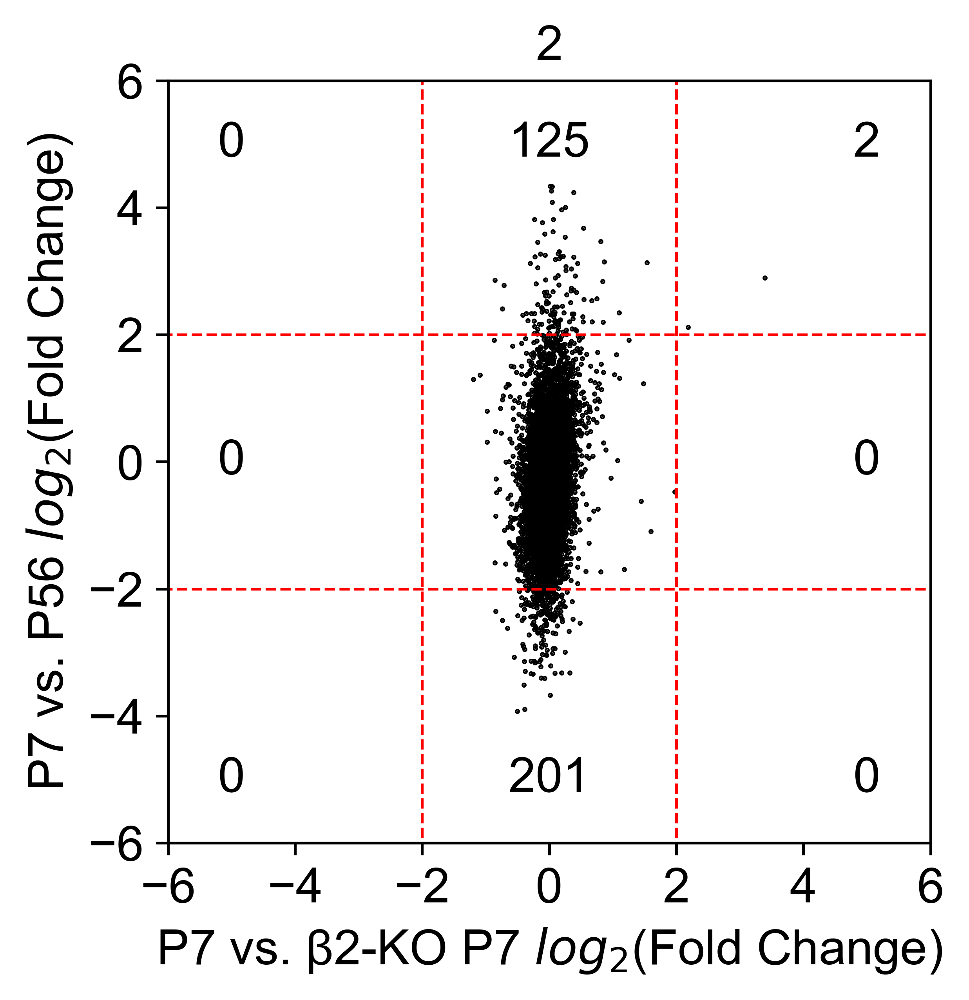

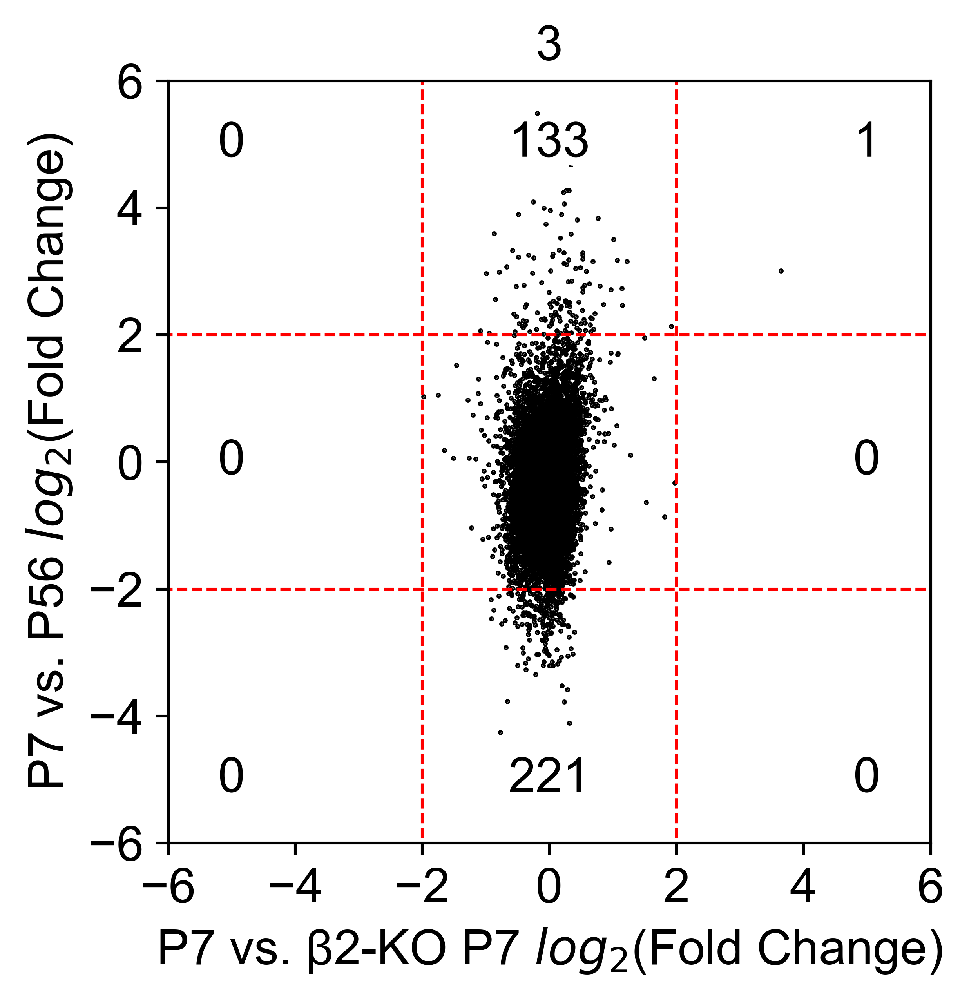

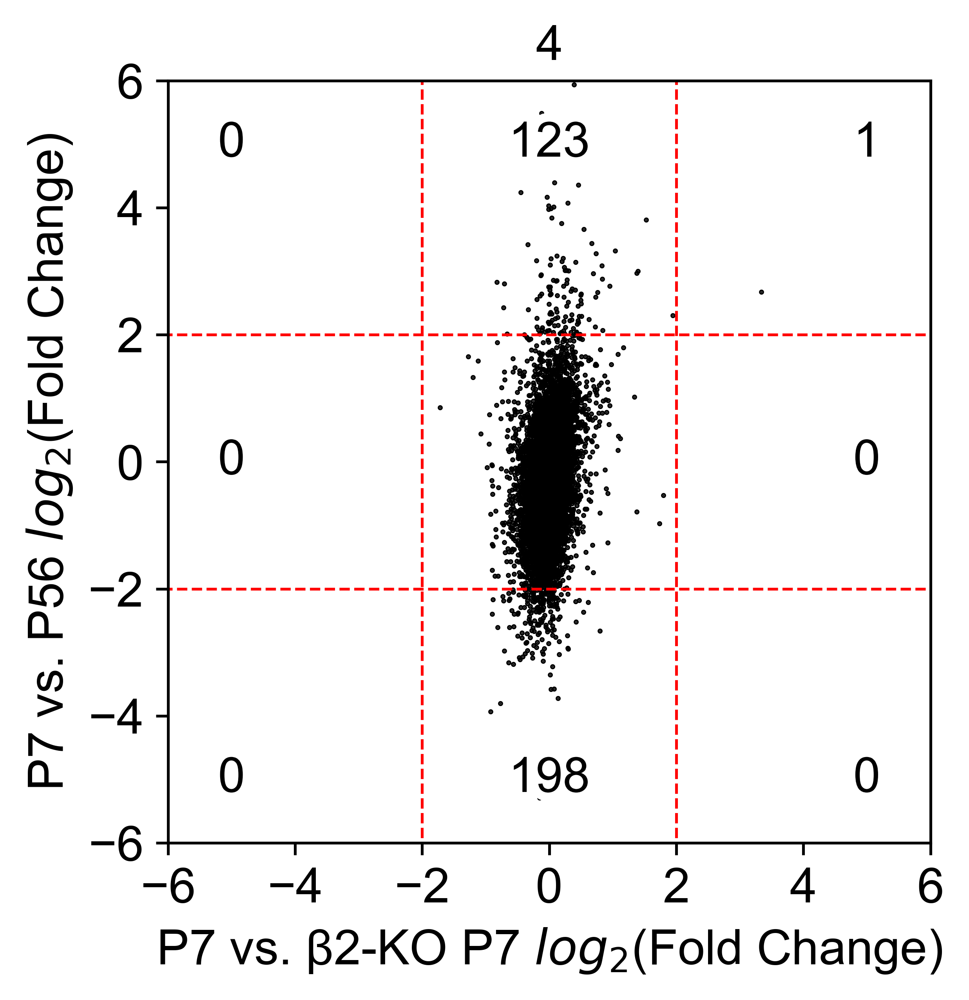

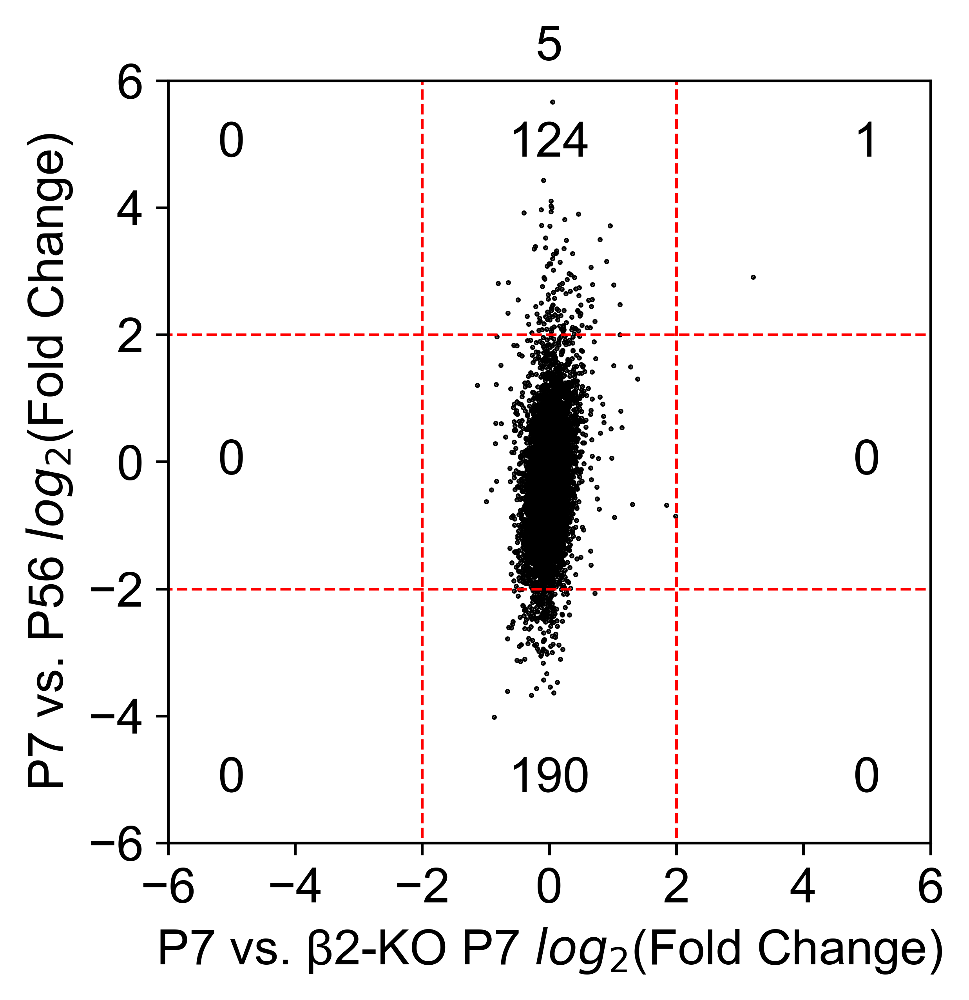

...

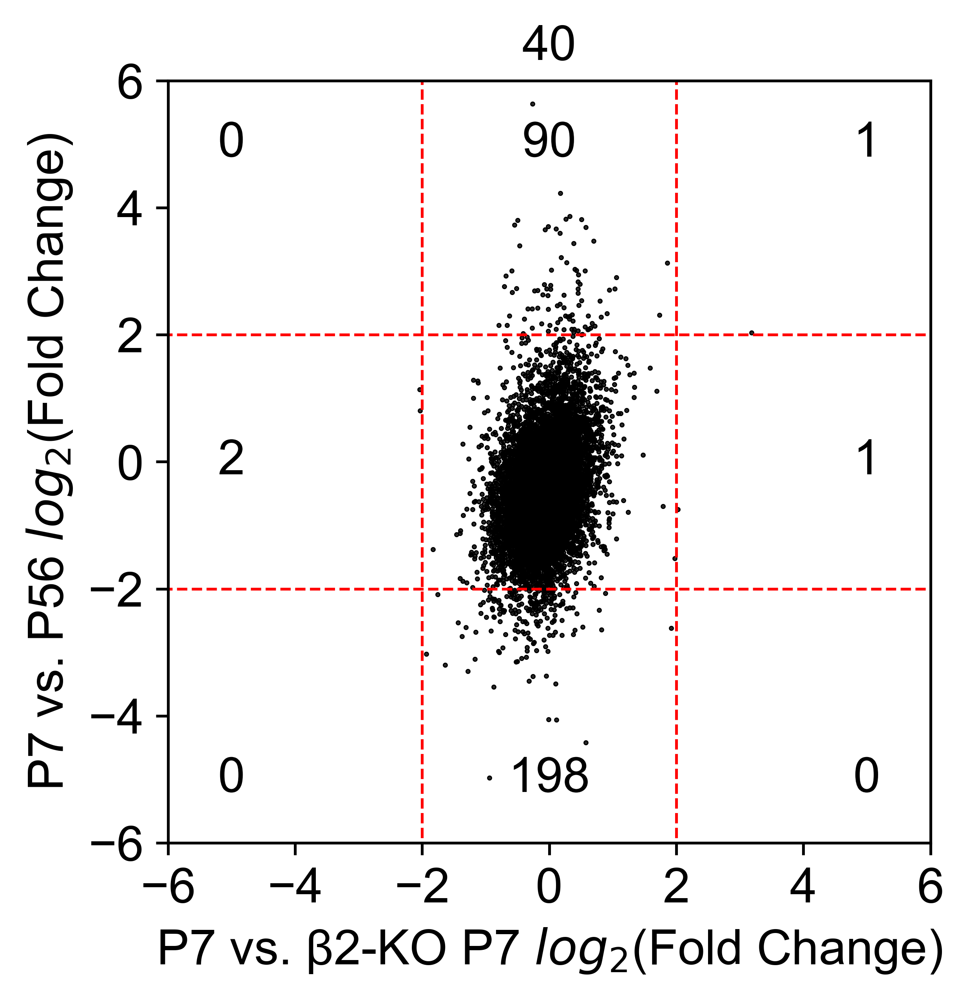

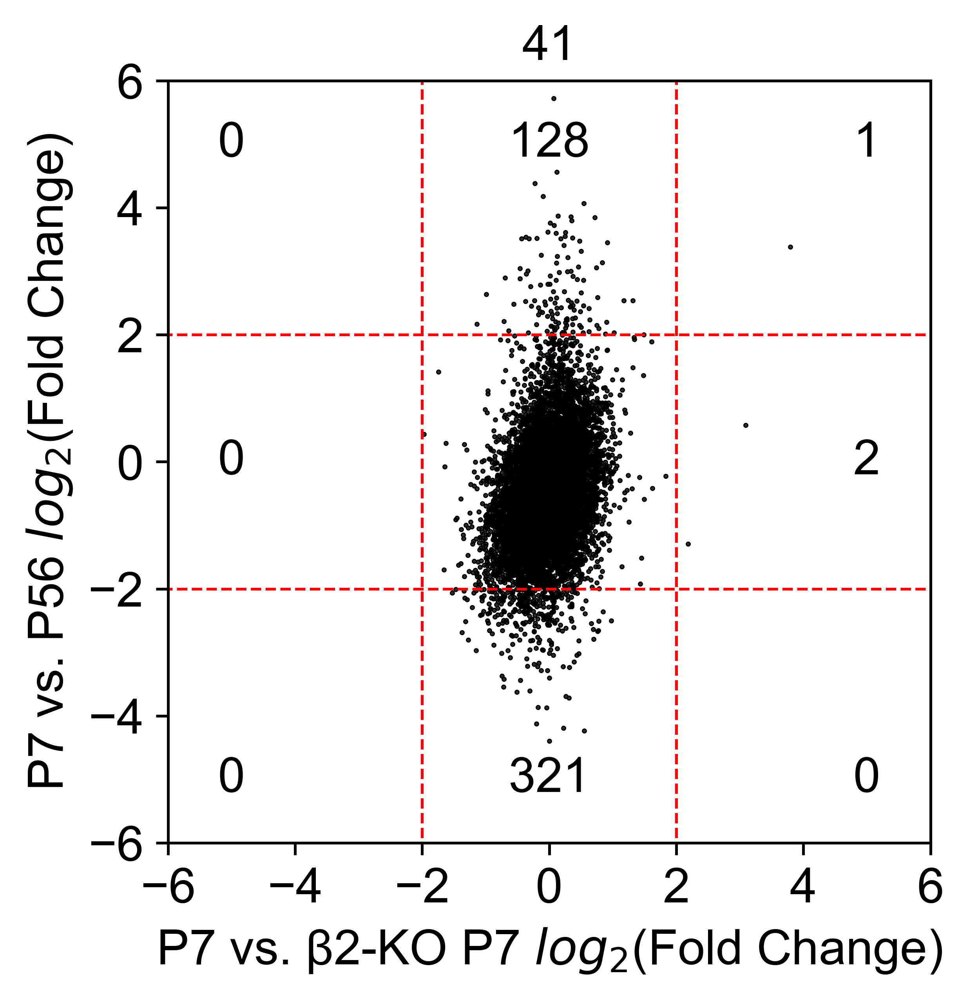

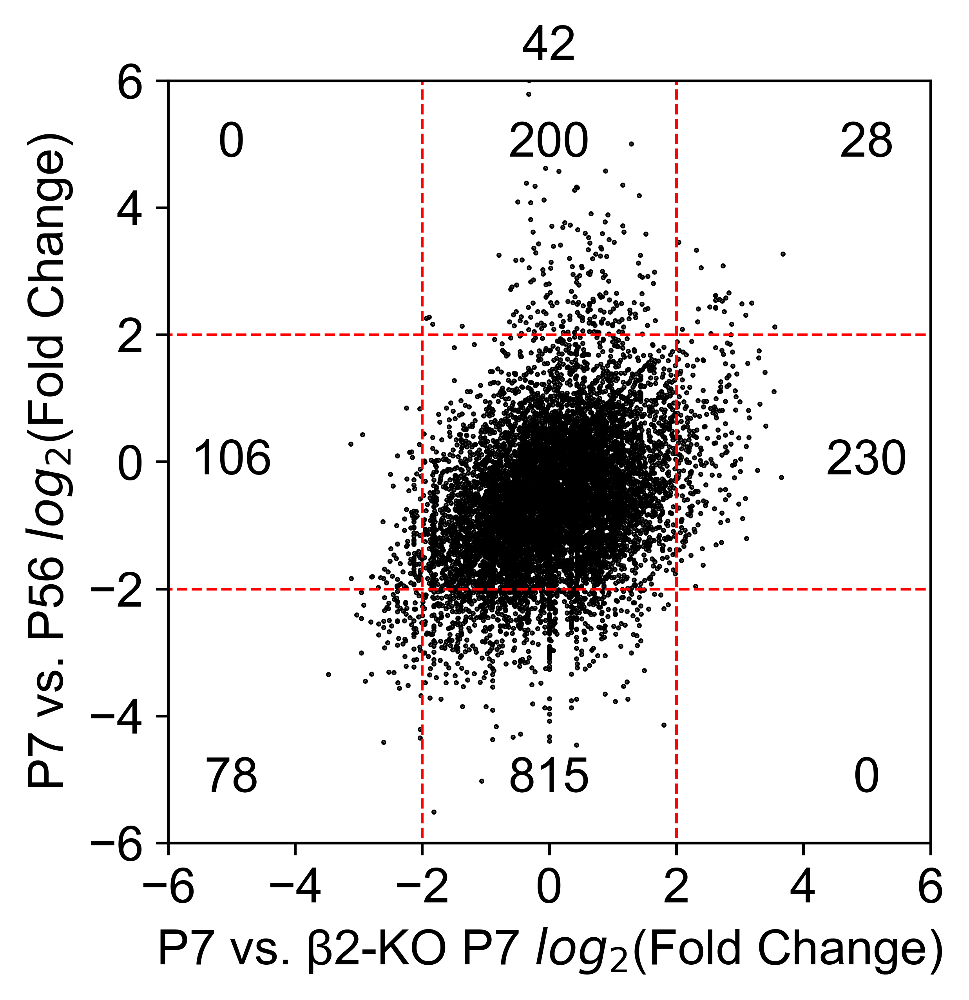

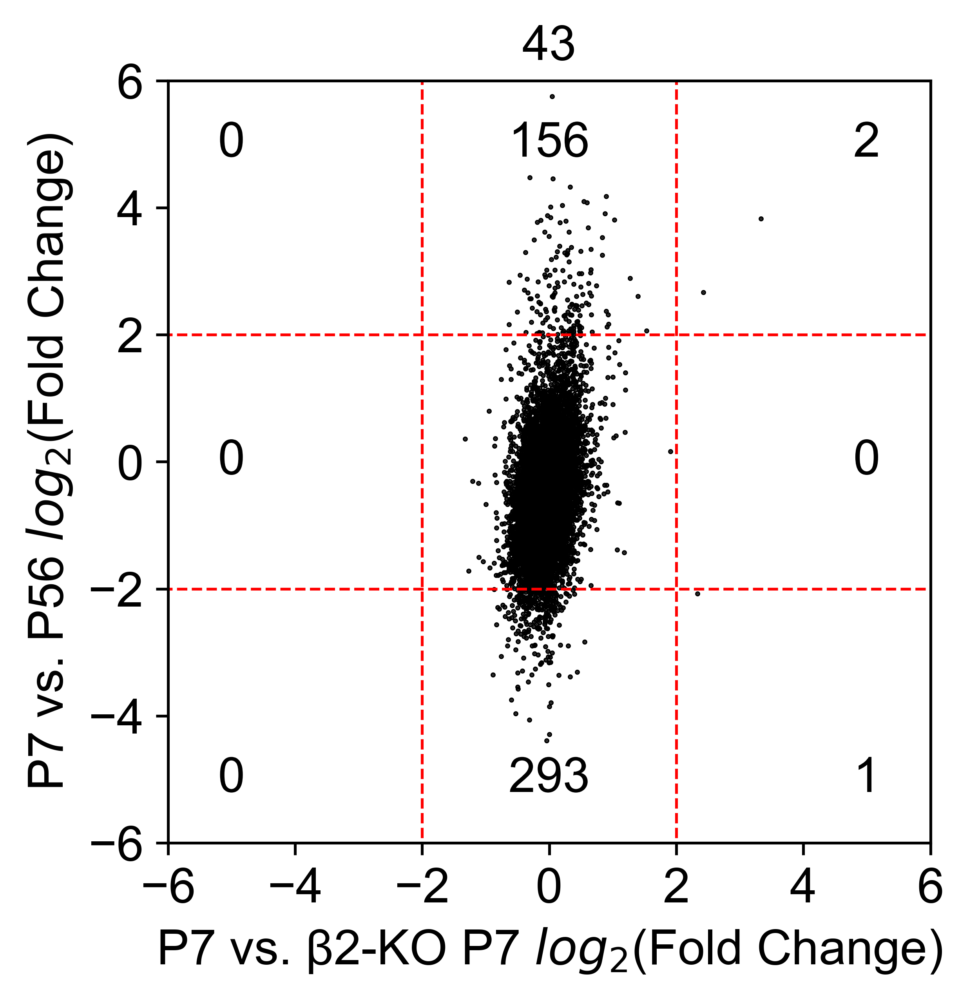

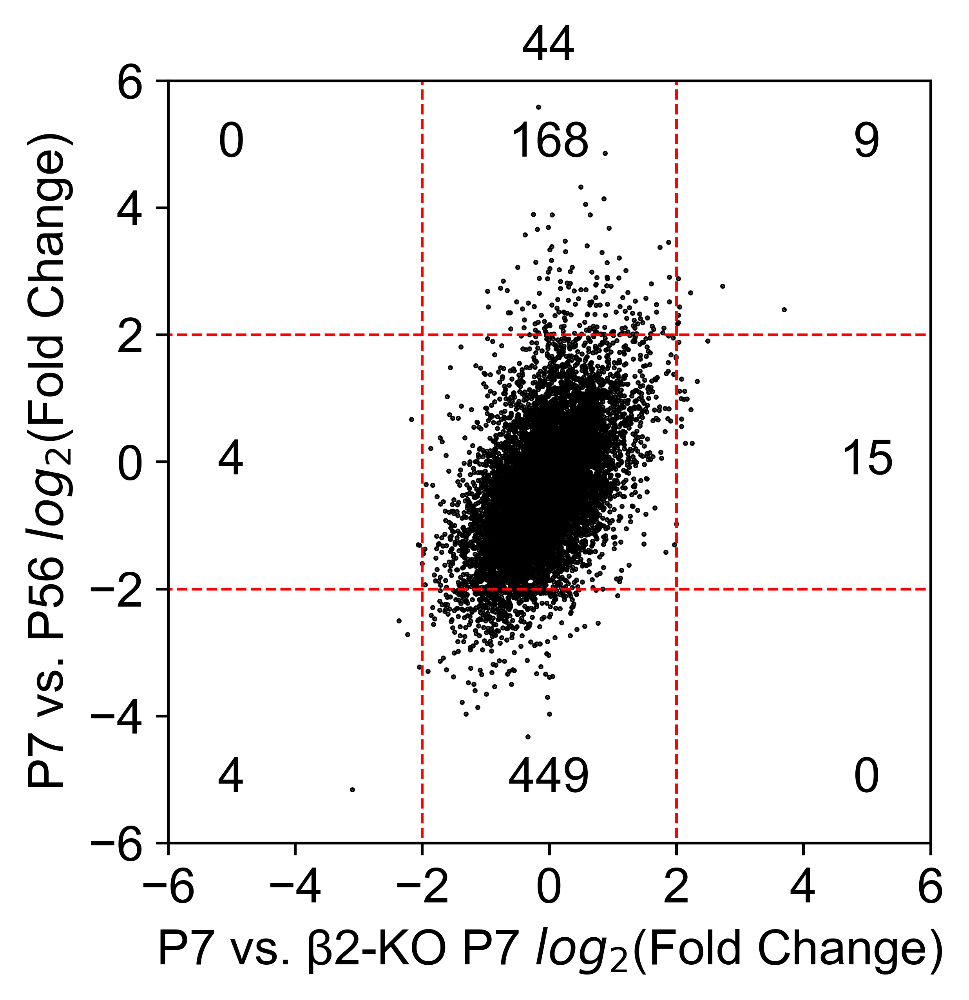

In [87]:
for cluster in range(44):
    plt.figure()
    make_scatter(p7_p7b2_fold_changes_by_type[cluster], p7_p56_fold_changes_by_type[cluster], [p7_p7b2_blacklist_by_type[cluster], p7_p56_blacklist_by_type[cluster], p7_p5_blacklist_by_type[cluster]], 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7 vs. P56 $log_2$(Fold Change)', 'testing.png')
    plt.title(cluster+1)

In [88]:
test_list = []
for i in range(len(p7_p56_fold_changes_by_type[43])):
    if p7_p56_fold_changes_by_type[43][i] == 1:
        if p7_p7b2_fold_changes_by_type[43][i] != 1:
            test_list.append(1)
        else:
            test_list.append(0)
    else:
        test_list.append(0)

In [89]:
sum(test_list)

882

In [90]:
test_list.index(1)

19

In [91]:
[gene_names[i] for i in range(len(test_list)) if test_list[i]]

['Sgk3',
 'Mcmdc2',
 'Pi15',
 'Neurl3',
 'Arid5a',
 'Fam178b',
 'Npas2',
 '8430432A02Rik',
 'Rftn2',
 'Plcl1',
 'Gm11608',
 'Dytn',
 'Cps1',
 'Tns1',
 'BC035947',
 'Mogat1',
 'Col4a4',
 '4933407L21Rik',
 'Ecel1',
 'Kcnj13',
 'Mroh2a',
 'Spp2',
 'Ano7',
 'Slco4c1',
 'Tfcp2l1',
 'Htr5b',
 'Optc',
 'Chit1',
 'Syt2',
 'Lgr6',
 'Elf3',
 'Lad1',
 'Cacna1s',
 'Lhx9',
 'Pdc',
 'Gm5532',
 'Angptl1',
 'Pappa2',
 'Serpinc1',
 'Fmo1',
 'Sft2d2',
 'Rcsd1',
 'Gm20711',
 'Rgs5',
 '3110045C21Rik',
 'Olfml2b',
 'Fcer1g',
 'Gm17224',
 'Gm10518',
 'Lefty2',
 'Ephx1',
 'A430110L20Rik',
 'Cenpf',
 'Nsl1',
 'Traf5',
 'Gm10516',
 'Gm15867',
 'Cr2',
 '1700080N15Rik',
 'Gm13391',
 'Prkcq',
 'Cubn',
 'Slc39a12',
 'Gm13375',
 'Mastl',
 'Gm13563',
 'Adamtsl2',
 'Fibcd1',
 'Aif1l',
 'Morn5',
 'Ptgs1',
 'Lhx2',
 'Gm13589',
 'Neb',
 'Gm13572',
 'Gm13620',
 'Ly75',
 'Itgb6',
 'Xirp2',
 'Lrp2',
 'Erich2',
 'Gm26558',
 'Chrna1',
 'Ppp1r1c',
 'Tfpi',
 'Serping1',
 'Cd44',
 '4931422A03Rik',
 'Ccdc73',
 'Muc15',
 'Thbs1',

C:\Users\pomat\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


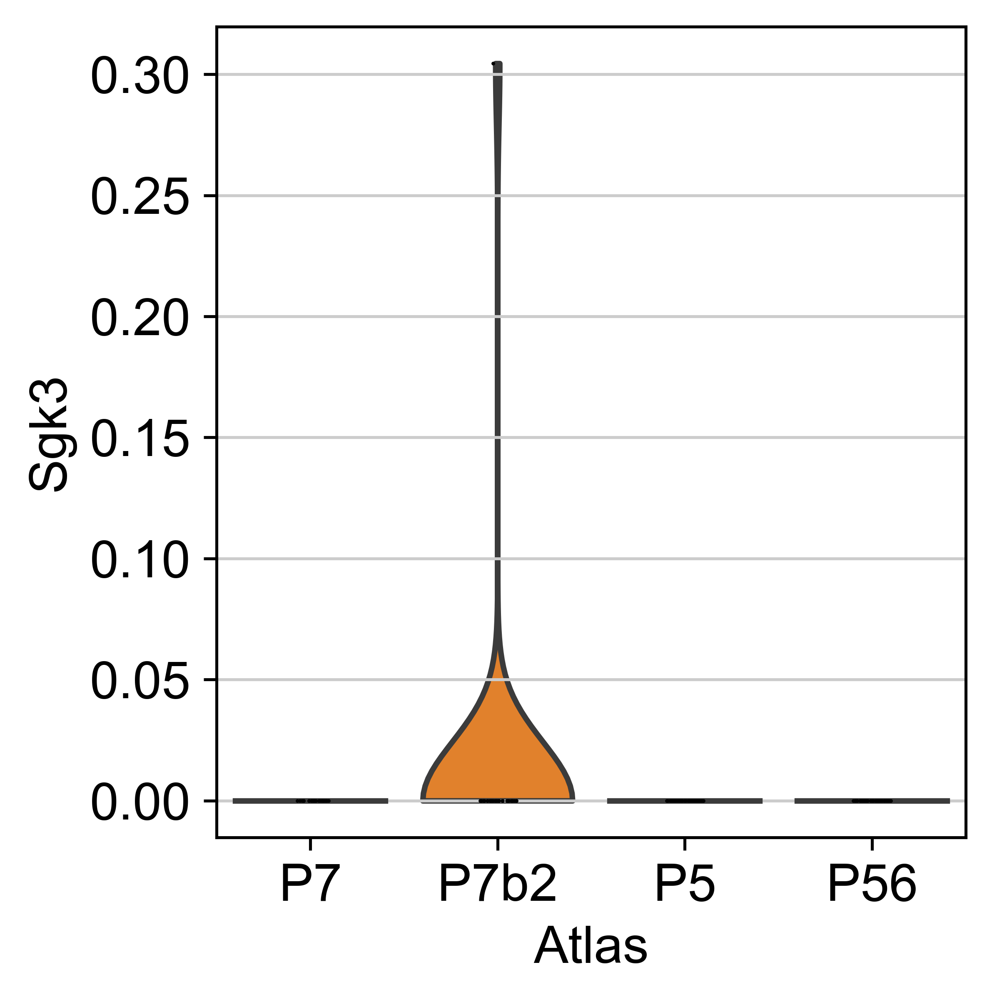

In [92]:
sc.pl.violin(p7_p5_p56_combined_adata[p7_p5_p56_combined_adata.obs['P56_type'].isin([44, '44'])], 'Sgk3', 'Atlas')

In [93]:
p5_mean_exp_by_type[0]

matrix([[1.1417358 , 0.9441489 , 0.3179655 , ..., 0.13480732, 0.19450063,
         0.07261578]], dtype=float32)

In [94]:
print(p5_mean_exp_by_type[43][0, 14])
print(p7_mean_exp_by_type[43][0, 14])
print(p56_mean_exp_by_type[43][0, 14])
print(p7b2_mean_exp_by_type[43][0, 14])

0.119514555
0.11230439
0.48277757
0.15965438


In [95]:
print(p7_p56_fold_changes_by_type[43][14])
print(p7_p7b2_fold_changes_by_type[43][14])

0.3642974643598727
0.817642245755872


In [96]:
for i in range(44):
    p7 = len(p7_adata[p7_adata.obs['P56_type'] == i+1].obs)
    p7b2 = len(p7b2_adata[p7b2_adata.obs['P56_type'] == i+1].obs)
    p5 = len(p5_adata[p5_adata.obs['P56_type'] == i+1].obs)
    p56 = len(p56_adata[p56_adata.obs['P56_type'] == i+1].obs)
    print(i+1, p7, p7b2, p5, p56)

1 963 671 1517 3000
2 837 1347 454 2859
3 1228 1283 992 1990
4 897 875 631 1868
5 853 538 704 1715
6 693 617 639 1590
7 753 928 773 1579
8 737 721 652 1258
9 237 168 310 1223
10 450 382 525 1170
11 761 872 638 990
12 558 631 307 953
13 512 582 539 943
14 406 507 335 875
15 346 443 291 865
16 445 475 457 829
17 289 370 332 828
18 509 470 454 826
19 462 180 223 775
20 483 360 247 711
21 325 319 569 687
22 302 259 265 610
23 465 338 366 601
24 116 48 267 553
25 97 203 480 542
26 213 186 186 534
27 52 105 266 529
28 142 263 443 517
29 240 196 368 499
30 221 237 235 491
31 297 199 278 444
32 223 139 281 407
33 158 176 143 323
34 283 214 210 312
35 342 151 333 310
36 177 75 240 236
37 110 99 94 213
38 55 8 178 207
39 43 140 50 202
40 151 107 14 174
41 24 30 56 126
42 10 2 31 113
43 90 92 26 106
44 25 37 73 62


In [98]:
adata_combined_p7_type_list = []
for i in tqdm(biological_types[:-1]):
    P56_type = int(i.split('_')[0])
    p7_adata_type = p7_adata[p7_adata.obs['P56_type'] == P56_type]
    p7b2_adata_type = p7b2_adata[p7b2_adata.obs['P56_type'] == P56_type]
    
    combined_p7_adata_type = ad.concat([p7_adata_type, p7b2_adata_type], label='Condition', keys=['WT', 'β2-KO'])
    
    sc.tl.rank_genes_groups(combined_p7_adata_type, groupby='Condition', method='wilcoxon')
    
    adata_combined_p7_type_list.append(combined_p7_adata_type)

100%|██████████████████████████████████████████████████████████████████████████████████| 44/44 [01:52<00:00,  2.56s/it]


In [99]:
kcnk9_pvals_by_type = []
chrnb2_pvals_by_type = []
for i in adata_combined_p7_type_list:
    type_df = sc.get.rank_genes_groups_df(i, 'WT')
    kcnk9_pvals_by_type.append(type_df[type_df.names == 'Kcnk9'].pvals_adj.values[0])
    chrnb2_pvals_by_type.append(type_df[type_df.names == 'Chrnb2'].pvals_adj.values[0])

In [100]:
gene_names.index('Kcnk9')

13336

In [101]:
kcnk9_fcs_by_type = []
chrnb2_fcs_by_type = []
for i in p7_p7b2_fold_changes_by_type:
    kcnk9_fcs_by_type.append(i[gene_names.index('Kcnk9')])
    chrnb2_fcs_by_type.append(i[gene_names.index('Chrnb2')])

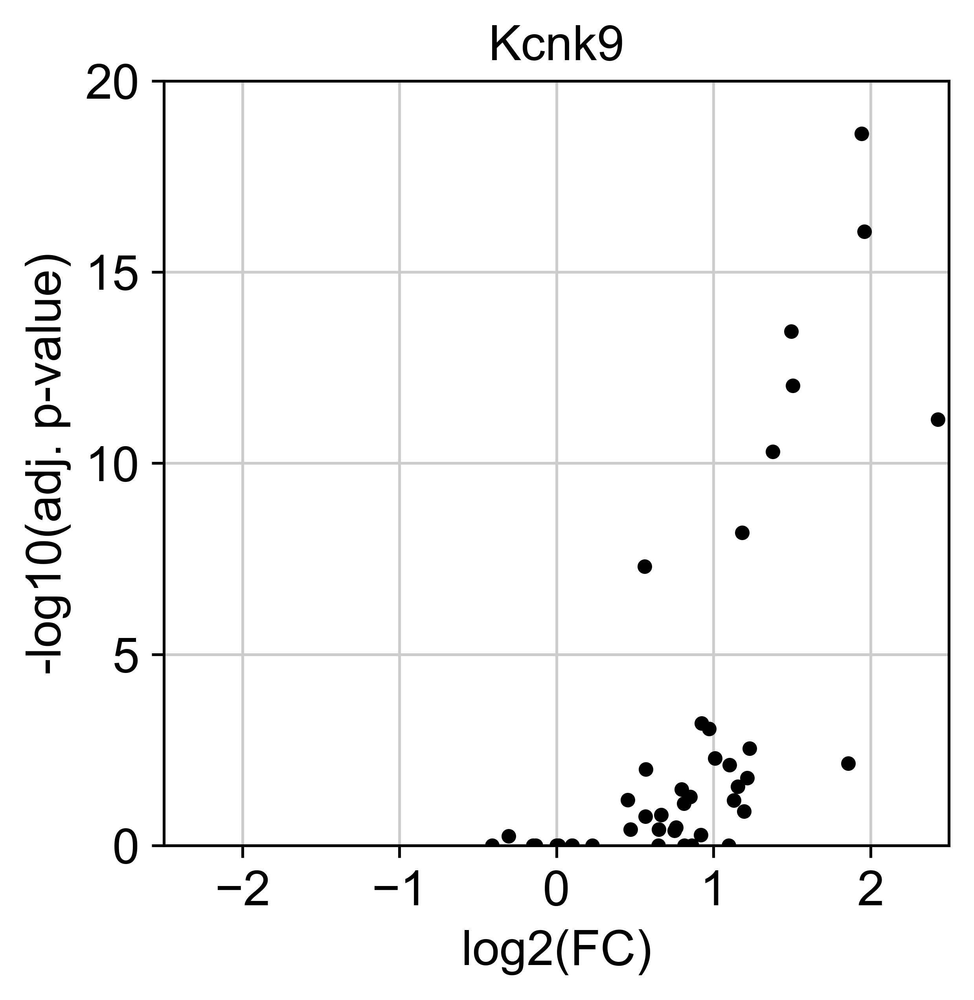

In [102]:
plt.scatter(np.log2(kcnk9_fcs_by_type), -np.log10(kcnk9_pvals_by_type), s=10, c='black')
plt.xlim([-2.5, 2.5])
plt.ylim([0,20])
plt.xlabel('log2(FC)')
plt.ylabel('-log10(adj. p-value)')
plt.title('Kcnk9')
ax = plt.gca()
ax.set_axisbelow(True)
plt.savefig('Kcnk9_volcano.svg')

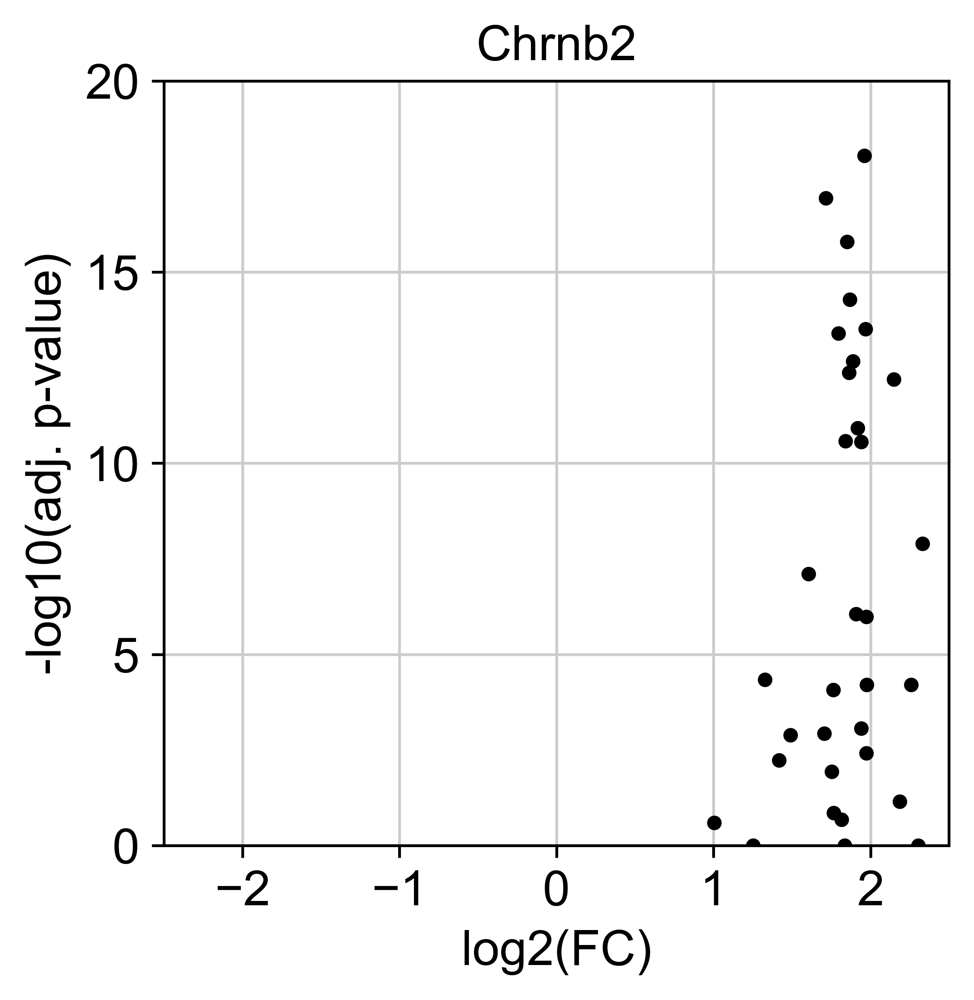

In [103]:
plt.scatter(np.log2(chrnb2_fcs_by_type), -np.log10(chrnb2_pvals_by_type), s=10, c='black')
plt.xlim([-2.5, 2.5])
plt.ylim([0,20])
plt.xlabel('log2(FC)')
plt.ylabel('-log10(adj. p-value)')
plt.title('Chrnb2')
ax = plt.gca()
ax.set_axisbelow(True)
plt.savefig('Chrnb2_volcano.svg')

In [104]:
DE_p7_genes_by_type = []
DE_p7b2_genes_by_type = []
DE_all_p7_genes_by_type = []
for i in range(len(adata_combined_p7_type_list)):
    type_df = sc.get.rank_genes_groups_df(adata_combined_p7_type_list[i], 'WT', pval_cutoff=0.05)
    type_df = type_df[type_df.names.isin(gene_names)]
    type_genes_p7 = []
    type_genes_p7b2 = []
    type_genes_all = []
    for j in type_df.names:
        fc_index = gene_names.index(j)
        if np.log2(p7_p7b2_fold_changes_by_type[i][fc_index]) > 1.5:
            type_genes_p7.append(j)
            type_genes_all.append(j)
        elif np.log2(p7_p7b2_fold_changes_by_type[i][fc_index]) < -1.5:
            type_genes_p7b2.append(j)
            type_genes_all.append(j)
    DE_p7_genes_by_type.append(type_genes_p7)
    DE_p7b2_genes_by_type.append(type_genes_p7b2)
    DE_all_p7_genes_by_type.append(type_genes_all)

100%|█████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 376.99it/s]


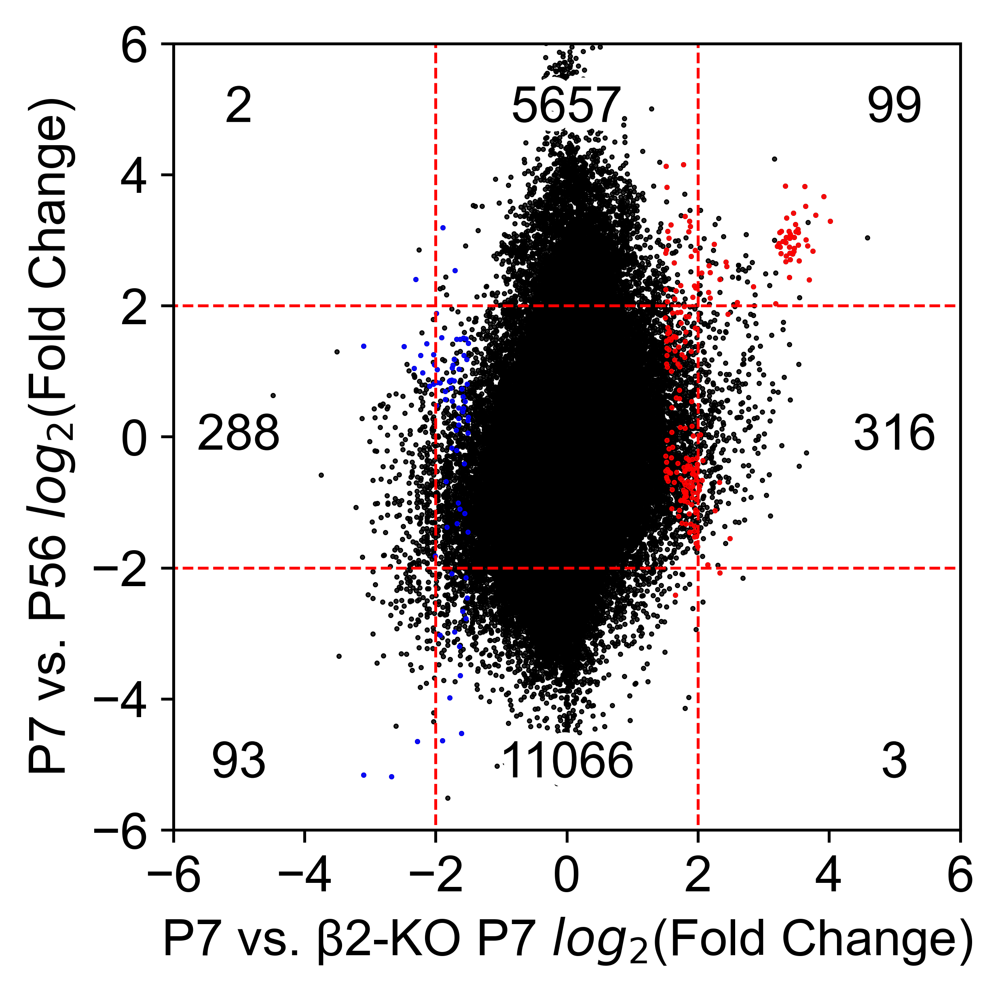

In [105]:
make_type_scatter(p7_p7b2_fold_changes_by_type, p7_p56_fold_changes_by_type, [p7_p7b2_blacklist_by_type, p7_p56_blacklist_by_type, p7_p5_blacklist_by_type], 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7 vs. P56 $log_2$(Fold Change)', 'P7vsP7b2-P7vsP56_type.png', DE_p7_genes_by_type, DE_p7b2_genes_by_type)

100%|█████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 206.57it/s]


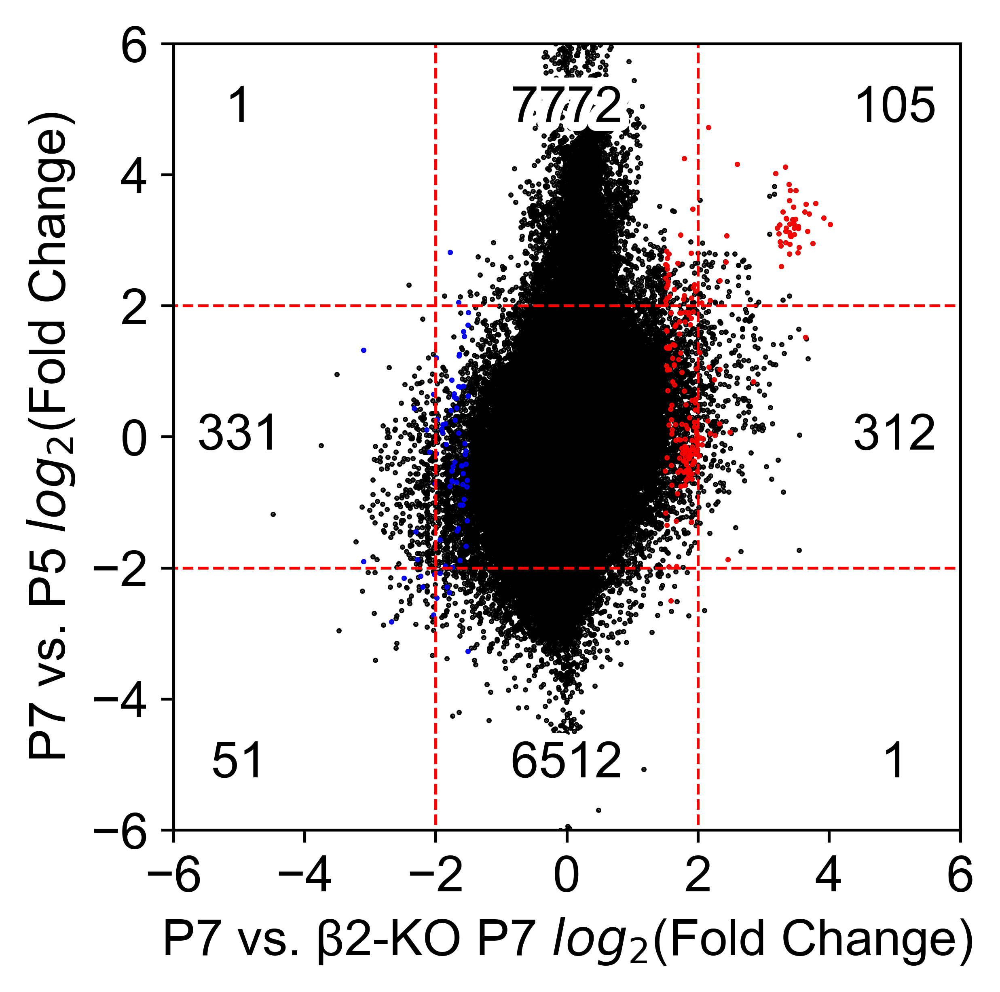

In [106]:
make_type_scatter(p7_p7b2_fold_changes_by_type, p7_p5_fold_changes_by_type, [p7_p7b2_blacklist_by_type, p7_p56_blacklist_by_type, p7_p5_blacklist_by_type], 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7 vs. P5 $log_2$(Fold Change)', 'P7vsP7b2-P7vsP5_type.png', DE_p7_genes_by_type, DE_p7b2_genes_by_type)

100%|█████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 298.29it/s]


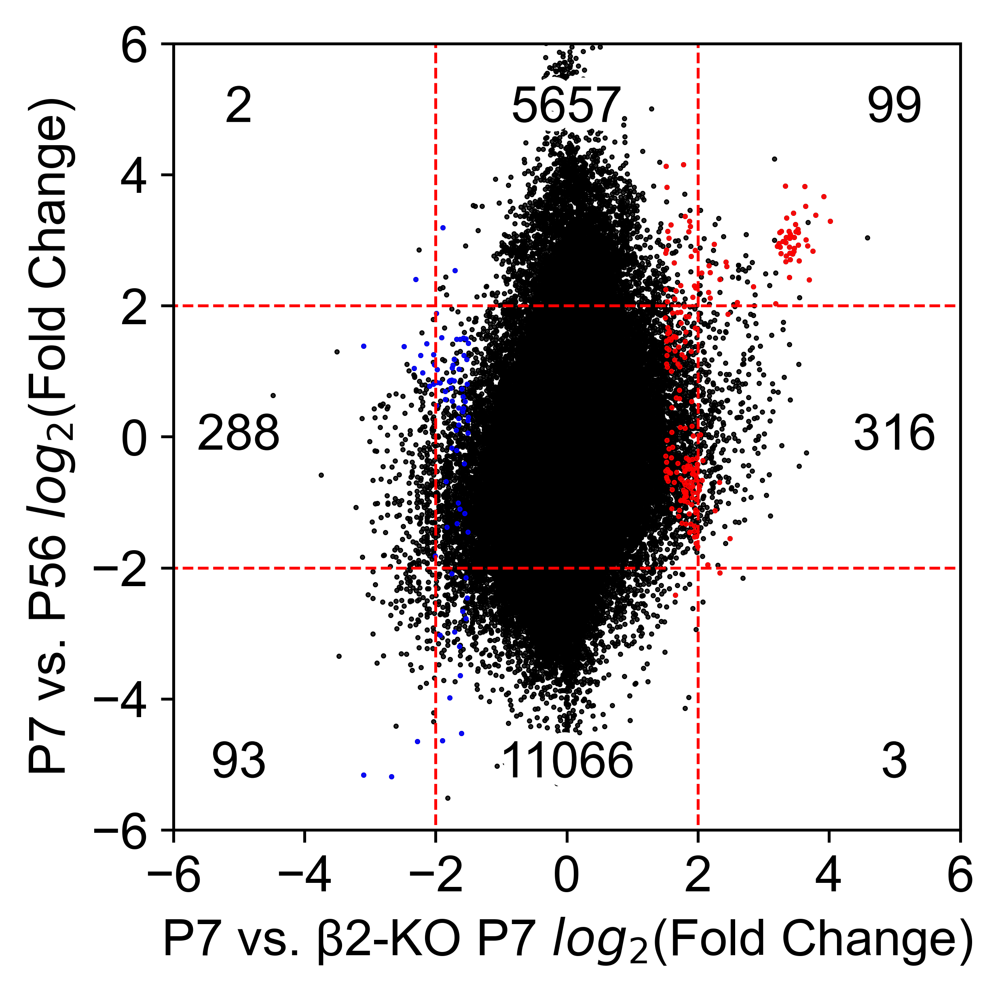

In [107]:
make_type_scatter(p7_p7b2_fold_changes_by_type, p7_p56_fold_changes_by_type, [p7_p7b2_blacklist_by_type, p7_p56_blacklist_by_type, p7_p5_blacklist_by_type], 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7 vs. P56 $log_2$(Fold Change)', 'P7vsP7b2-P7vsP56_type.svg', DE_p7_genes_by_type, DE_p7b2_genes_by_type)

100%|█████████████████████████████████████████████████████████████████████████████████| 44/44 [00:00<00:00, 355.41it/s]


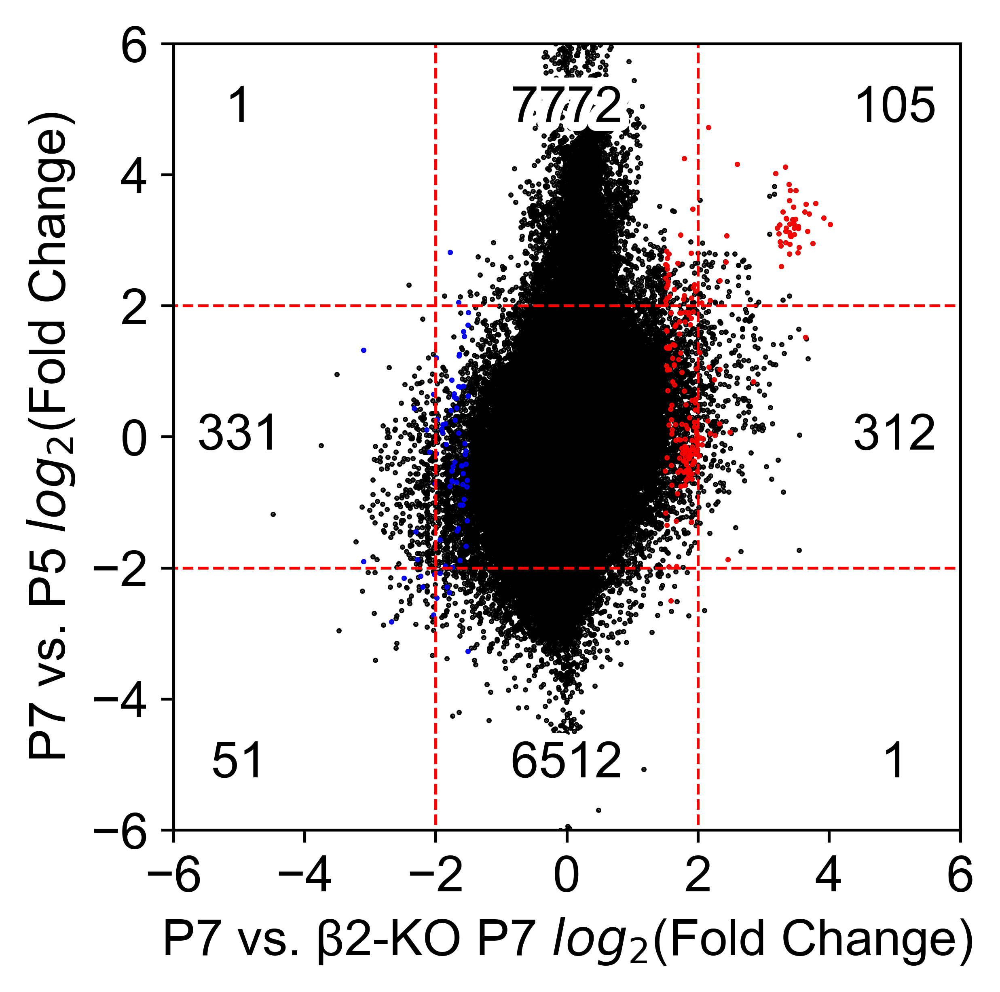

In [108]:
make_type_scatter(p7_p7b2_fold_changes_by_type, p7_p5_fold_changes_by_type, [p7_p7b2_blacklist_by_type, p7_p56_blacklist_by_type, p7_p5_blacklist_by_type], 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7 vs. P5 $log_2$(Fold Change)', 'P7vsP7b2-P7vsP5_type.svg', DE_p7_genes_by_type, DE_p7b2_genes_by_type)

In [109]:
p7_DE_type_genes_flat = []
for i in DE_p7_genes_by_type:
    for j in i:
        if j not in p7_DE_type_genes_flat:
            p7_DE_type_genes_flat.append(j)

In [110]:
len(p7_DE_type_genes_flat)

46

In [111]:
p7b2_DE_type_genes_flat = []
for i in DE_p7b2_genes_by_type:
    for j in i:
        if j not in p7b2_DE_type_genes_flat:
            p7b2_DE_type_genes_flat.append(j)

In [112]:
len(p7b2_DE_type_genes_flat)

42

In [113]:
p7_string = ""
for i in p7_DE_type_genes_flat:
    p7_string += i + " "

In [114]:
p7b2_string = ""
for i in p7b2_DE_type_genes_flat:
    p7b2_string += i + " "

In [115]:
p7_string

'Gm10076 Erh Gstp1 Chrnb2 Lgals7 Pcp4 Uba52 Cd24a Kcnk9 Meis2 Npnt Mafb Rgs4 Rprm Rgs7bp Piezo2 Rnd3 Cabp1 Isl2 Anxa2 Kcnip4 Nr2f1 Tmem196 Nts Bnc2 Gabra5 Rapsn Sgcz Crym Slc17a7 Pou6f2 Kitl Calb2 Lor Ebf3 Maf Cdkl4 Gm17750 Anxa3 Chst15 Pcp4l1 S100a11 Lgals1 Gabrg3 Plcb1 Nefm '

In [116]:
p7b2_string

'Tsix Tac1 Nme7 Cntnap5a Penk Sparc Rhox5 Nfat5 Scg2 Cacna1d Xist Gm16105 Rmst Cdkn1c Lrrn3 Grin2a Kcnc2 Lars2 Galntl6 Clmp Cdh13 Creg2 Mstn Plxnc1 Pcdh19 Tenm1 Slc6a1 Per3 Mgarp Txnip Neto2 Ajap1 Prdm8 Junb C1ql2 Spon1 Coch Fos Unc5d Gldn March7 Casc4 '

In [117]:
new_list = []
for i in DE_all_p7_genes_by_type:
    for j in i:
        new_list.append(j)

In [118]:
len(new_list)

295

In [119]:
p7rep1_mean_exp_by_type = []
p7rep2_mean_exp_by_type = []
p7rep3_mean_exp_by_type = []

p7b2rep1_mean_exp_by_type = []
p7b2rep2_mean_exp_by_type = []
p7b2rep3_mean_exp_by_type = []

p7rep1_cell_pcts_by_type = []
p7rep2_cell_pcts_by_type = []
p7rep3_cell_pcts_by_type = []

p7b2rep1_cell_pcts_by_type = []
p7b2rep2_cell_pcts_by_type = []
p7b2rep3_cell_pcts_by_type = []
for i in tqdm(biological_types[:-1]):
    P56_type = int(i.split('_')[0])

    if P56_type != 42:
        # print(P56_type)
    
        p7_adata_type = p7_adata[p7_adata.obs["P56_type"] == P56_type]
        
        p7rep1_adata_raw_type = p7_adata_type[p7_adata_type.obs["Batch"] == "Batch1"].raw
        p7rep2_adata_raw_type = p7_adata_type[p7_adata_type.obs["Batch"] == "Batch2"].raw
        p7rep3_adata_raw_type = p7_adata_type[p7_adata_type.obs["Batch"] == "Batch3"].raw
        
        p7b2_adata_type = p7b2_adata[p7b2_adata.obs["P56_type"] == P56_type]
        
        p7b2rep1_adata_raw_type = p7b2_adata_type[p7b2_adata_type.obs["Batch"].isin(["Batch1", "Batch2"])].raw
        p7b2rep2_adata_raw_type = p7b2_adata_type[p7b2_adata_type.obs["Batch"] == "Batch1_2"].raw
        p7b2rep3_adata_raw_type = p7b2_adata_type[p7b2_adata_type.obs["Batch"] == "Batch2_2"].raw
        
        p7rep1_adata_slice_type = p7rep1_adata_raw_type[:, common_genes]
        p7rep2_adata_slice_type = p7rep2_adata_raw_type[:, common_genes]
        p7rep3_adata_slice_type = p7rep3_adata_raw_type[:, common_genes]
        
        p7b2rep1_adata_slice_type = p7b2rep1_adata_raw_type[:, common_genes]
        p7b2rep2_adata_slice_type = p7b2rep2_adata_raw_type[:, common_genes]
        p7b2rep3_adata_slice_type = p7b2rep3_adata_raw_type[:, common_genes]
        
        p7rep1_log_gem_type = p7rep1_adata_slice_type.X
        p7rep2_log_gem_type = p7rep2_adata_slice_type.X
        p7rep3_log_gem_type = p7rep3_adata_slice_type.X
        
        p7b2rep1_log_gem_type = p7b2rep1_adata_slice_type.X
        p7b2rep2_log_gem_type = p7b2rep2_adata_slice_type.X
        p7b2rep3_log_gem_type = p7b2rep3_adata_slice_type.X
        
        p7rep1_gem_type = p7rep1_log_gem_type.expm1()
        p7rep2_gem_type = p7rep2_log_gem_type.expm1()
        p7rep3_gem_type = p7rep3_log_gem_type.expm1()
        
        p7b2rep1_gem_type = p7b2rep1_log_gem_type.expm1()
        p7b2rep2_gem_type = p7b2rep2_log_gem_type.expm1()
        p7b2rep3_gem_type = p7b2rep3_log_gem_type.expm1()
        
        p7rep1_mean_exp_type = p7rep1_gem_type.mean(0)
        p7rep2_mean_exp_type = p7rep2_gem_type.mean(0)
        p7rep3_mean_exp_type = p7rep3_gem_type.mean(0)
        
        p7b2rep1_mean_exp_type = p7b2rep1_gem_type.mean(0)
        p7b2rep2_mean_exp_type = p7b2rep2_gem_type.mean(0)
        p7b2rep3_mean_exp_type = p7b2rep3_gem_type.mean(0)
    
        p7rep1_mean_exp_by_type.append(p7rep1_mean_exp_type)
        p7rep2_mean_exp_by_type.append(p7rep2_mean_exp_type)
        p7rep3_mean_exp_by_type.append(p7rep3_mean_exp_type)
        
        p7b2rep1_mean_exp_by_type.append(p7b2rep1_mean_exp_type)
        p7b2rep2_mean_exp_by_type.append(p7b2rep2_mean_exp_type)
        p7b2rep3_mean_exp_by_type.append(p7b2rep3_mean_exp_type)
        
        p7rep1_count_type = p7rep1_adata_slice_type.X.shape[0]
        p7rep2_count_type = p7rep2_adata_slice_type.X.shape[0]
        p7rep3_count_type = p7rep3_adata_slice_type.X.shape[0]
        
        p7b2rep1_count_type = p7b2rep1_adata_slice_type.X.shape[0]
        p7b2rep2_count_type = p7b2rep2_adata_slice_type.X.shape[0]
        p7b2rep3_count_type = p7b2rep3_adata_slice_type.X.shape[0]
        
        p7rep1_raw_X_type = p7rep1_adata_slice_type.X
        p7rep1_raw_X_type.eliminate_zeros()
        p7rep1_raw_X_trans_type = p7rep1_raw_X_type.transpose().tocsr()
        p7rep1_cell_counts_type = p7rep1_raw_X_trans_type.indptr[1:] - p7rep1_raw_X_trans_type.indptr[:-1]
        
        p7rep2_raw_X_type = p7rep2_adata_slice_type.X
        p7rep2_raw_X_type.eliminate_zeros()
        p7rep2_raw_X_trans_type = p7rep2_raw_X_type.transpose().tocsr()
        p7rep2_cell_counts_type = p7rep2_raw_X_trans_type.indptr[1:] - p7rep2_raw_X_trans_type.indptr[:-1]
        
        p7rep3_raw_X_type = p7rep3_adata_slice_type.X
        p7rep3_raw_X_type.eliminate_zeros()
        p7rep3_raw_X_trans_type = p7rep3_raw_X_type.transpose().tocsr()
        p7rep3_cell_counts_type = p7rep3_raw_X_trans_type.indptr[1:] - p7rep3_raw_X_trans_type.indptr[:-1]
        
        p7b2rep1_raw_X_type = p7b2rep1_adata_slice_type.X
        p7b2rep1_raw_X_type.eliminate_zeros()
        p7b2rep1_raw_X_trans_type = p7b2rep1_raw_X_type.transpose().tocsr()
        p7b2rep1_cell_counts_type = p7b2rep1_raw_X_trans_type.indptr[1:] - p7b2rep1_raw_X_trans_type.indptr[:-1]
        
        p7b2rep2_raw_X_type = p7b2rep2_adata_slice_type.X
        p7b2rep2_raw_X_type.eliminate_zeros()
        p7b2rep2_raw_X_trans_type = p7b2rep2_raw_X_type.transpose().tocsr()
        p7b2rep2_cell_counts_type = p7b2rep2_raw_X_trans_type.indptr[1:] - p7b2rep2_raw_X_trans_type.indptr[:-1]
        
        p7b2rep3_raw_X_type = p7b2rep3_adata_slice_type.X
        p7b2rep3_raw_X_type.eliminate_zeros()
        p7b2rep3_raw_X_trans_type = p7b2rep3_raw_X_type.transpose().tocsr()
        p7b2rep3_cell_counts_type = p7b2rep3_raw_X_trans_type.indptr[1:] - p7b2rep3_raw_X_trans_type.indptr[:-1]
        
        p7rep1_cell_pcts_type = p7rep1_cell_counts_type/p7rep1_count_type
        p7rep2_cell_pcts_type = p7rep2_cell_counts_type/p7rep2_count_type
        p7rep3_cell_pcts_type = p7rep3_cell_counts_type/p7rep3_count_type
        
        p7b2rep1_cell_pcts_type = p7b2rep1_cell_counts_type/p7b2rep1_count_type
        p7b2rep2_cell_pcts_type = p7b2rep2_cell_counts_type/p7b2rep2_count_type
        p7b2rep3_cell_pcts_type = p7b2rep3_cell_counts_type/p7b2rep3_count_type
    
        p7rep1_cell_pcts_by_type.append(p7rep1_cell_pcts_type)
        p7rep2_cell_pcts_by_type.append(p7rep2_cell_pcts_type)
        p7rep3_cell_pcts_by_type.append(p7rep3_cell_pcts_type)
        
        p7b2rep1_cell_pcts_by_type.append(p7b2rep1_cell_pcts_type)
        p7b2rep2_cell_pcts_by_type.append(p7b2rep2_cell_pcts_type)
        p7b2rep3_cell_pcts_by_type.append(p7b2rep3_cell_pcts_type)

100%|██████████████████████████████████████████████████████████████████████████████████| 44/44 [00:24<00:00,  1.80it/s]


In [120]:
p7rep1_p7rep2_fold_changes_by_type = []
p7rep1_p7rep3_fold_changes_by_type = []
p7rep2_p7rep3_fold_changes_by_type = []
p7b2rep1_p7b2rep2_fold_changes_by_type = []
p7b2rep1_p7b2rep3_fold_changes_by_type = []
p7b2rep2_p7b2rep3_fold_changes_by_type = []
for j in tqdm(range(len(p7rep1_mean_exp_by_type))):
    p7rep1_p7rep2_fold_changes_type = []
    p7rep1_p7rep3_fold_changes_type = []
    p7rep2_p7rep3_fold_changes_type = []
    p7b2rep1_p7b2rep2_fold_changes_type = []
    p7b2rep1_p7b2rep3_fold_changes_type = []
    p7b2rep2_p7b2rep3_fold_changes_type = []
    for i in range(p5_mean_exp.shape[1]):
        gene_name = list(p5_adata_slice.var_names)[i]
        p7_index = list(p7_adata_slice.var_names).index(gene_name)

        pseudocount = 0.1
        #if (p5_mean_exp[0, p5_index] != 0) & (p7_mean_exp[0, p7_index] != 0) & (p56_mean_exp[0, p56_index] != 0) & (p7Batch2_mean_exp[0, p7_index] != 0) & (p7Batch3_mean_exp[0, p7_index] != 0) & (p5Batch3_mean_exp[0, p5_index] != 0) & (p5Batch5_mean_exp[0, p5_index] != 0):
        p7rep1_p7rep2_fold_change = (p7rep1_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p7rep2_mean_exp_by_type[j][0, p7_index]+pseudocount)
        p7rep1_p7rep2_fold_changes_type.append(p7rep1_p7rep2_fold_change)
        p7rep1_p7rep3_fold_change = (p7rep1_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p7rep3_mean_exp_by_type[j][0, p7_index]+pseudocount)
        p7rep1_p7rep3_fold_changes_type.append(p7rep1_p7rep3_fold_change)
        p7rep2_p7rep3_fold_change = (p7rep2_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p7rep3_mean_exp_by_type[j][0, p7_index]+pseudocount)
        p7rep2_p7rep3_fold_changes_type.append(p7rep2_p7rep3_fold_change)
    
        p7b2rep1_p7b2rep2_fold_change = (p7b2rep1_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p7b2rep2_mean_exp_by_type[j][0, p7_index]+pseudocount)
        p7b2rep1_p7b2rep2_fold_changes_type.append(p7b2rep1_p7b2rep2_fold_change)
        p7b2rep1_p7b2rep3_fold_change = (p7b2rep1_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p7b2rep3_mean_exp_by_type[j][0, p7_index]+pseudocount)
        p7b2rep1_p7b2rep3_fold_changes_type.append(p7b2rep1_p7b2rep3_fold_change)
        p7b2rep2_p7b2rep3_fold_change = (p7b2rep2_mean_exp_by_type[j][0, p7_index]+pseudocount)/(p7b2rep3_mean_exp_by_type[j][0, p7_index]+pseudocount)
        p7b2rep2_p7b2rep3_fold_changes_type.append(p7b2rep2_p7b2rep3_fold_change)
    p7rep1_p7rep2_fold_changes_by_type.append(p7rep1_p7rep2_fold_changes_type)
    p7rep1_p7rep3_fold_changes_by_type.append(p7rep1_p7rep3_fold_changes_type)
    p7rep2_p7rep3_fold_changes_by_type.append(p7rep2_p7rep3_fold_changes_type)
    p7b2rep1_p7b2rep2_fold_changes_by_type.append(p7b2rep1_p7b2rep2_fold_changes_type)
    p7b2rep1_p7b2rep3_fold_changes_by_type.append(p7b2rep1_p7b2rep3_fold_changes_type)
    p7b2rep2_p7b2rep3_fold_changes_by_type.append(p7b2rep2_p7b2rep3_fold_changes_type)

100%|██████████████████████████████████████████████████████████████████████████████████| 43/43 [20:04<00:00, 28.01s/it]


In [121]:
p7rep1_p7rep2_blacklist_by_type = []
p7rep1_p7rep3_blacklist_by_type = []
p7rep2_p7rep3_blacklist_by_type = []
p7b2rep1_p7b2rep2_blacklist_by_type = []
p7b2rep1_p7b2rep3_blacklist_by_type = []
p7b2rep2_p7b2rep3_blacklist_by_type = []
for i in tqdm(range(len(p7rep1_cell_pcts_by_type))):
    p7rep1_p7rep2_blacklist_type = []
    p7rep1_p7rep3_blacklist_type = []
    p7rep2_p7rep3_blacklist_type = []
    p7b2rep1_p7b2rep2_blacklist_type = []
    p7b2rep1_p7b2rep3_blacklist_type = []
    p7b2rep2_p7b2rep3_blacklist_type = []
    for i in range(p5_mean_exp.shape[1]):
        gene_name = list(p5_adata_slice.var_names)[i]
        p7_index = list(p7_adata_slice.var_names).index(gene_name)
    
        if p7rep1_cell_pcts[p7_index] < 0.05:
            if p7rep2_cell_pcts[p7_index] < 0.05:
                p7rep1_p7rep2_blacklist_type.append(i)
            if p7rep3_cell_pcts[p7_index] < 0.05:
                p7rep1_p7rep3_blacklist_type.append(i)
        if p7rep2_cell_pcts[p7_index] < 0.05:
            if p7rep3_cell_pcts[p7_index] < 0.05:
                p7rep2_p7rep3_blacklist_type.append(i)
        if p7b2rep1_cell_pcts[p7_index] < 0.05:
            if p7b2rep2_cell_pcts[p7_index] < 0.05:
                p7b2rep1_p7b2rep2_blacklist_type.append(i)
            if p7b2rep3_cell_pcts[p7_index] < 0.05:
                p7b2rep1_p7b2rep3_blacklist_type.append(i)
        if p7b2rep2_cell_pcts[p7_index] < 0.05:
            if p7b2rep3_cell_pcts[p7_index] < 0.05:
                p7b2rep2_p7b2rep3_blacklist_type.append(i)
    p7rep1_p7rep2_blacklist_by_type.append(p7rep1_p7rep2_blacklist_type)
    p7rep1_p7rep3_blacklist_by_type.append(p7rep1_p7rep3_blacklist_type)
    p7rep2_p7rep3_blacklist_by_type.append(p7rep2_p7rep3_blacklist_type)
    p7b2rep1_p7b2rep2_blacklist_by_type.append(p7b2rep1_p7b2rep2_blacklist_type)
    p7b2rep1_p7b2rep3_blacklist_by_type.append(p7b2rep1_p7b2rep3_blacklist_type)
    p7b2rep2_p7b2rep3_blacklist_by_type.append(p7b2rep2_p7b2rep3_blacklist_type)

100%|██████████████████████████████████████████████████████████████████████████████████| 43/43 [20:00<00:00, 27.92s/it]


In [122]:
pickle.dump(p7rep1_p7rep2_fold_changes_by_type, open('p7rep1_p7rep2_fold_changes_by_type', 'wb'))
pickle.dump(p7rep1_p7rep3_fold_changes_by_type, open('p7rep1_p7rep3_fold_changes_by_type', 'wb'))
pickle.dump(p7rep2_p7rep3_fold_changes_by_type, open('p7rep2_p7rep3_fold_changes_by_type', 'wb'))
pickle.dump(p7b2rep1_p7b2rep2_fold_changes_by_type, open('p7b2rep1_p7b2rep2_fold_changes_by_type', 'wb'))
pickle.dump(p7b2rep1_p7b2rep3_fold_changes_by_type, open('p7b2rep1_p7b2rep3_fold_changes_by_type', 'wb'))
pickle.dump(p7b2rep2_p7b2rep3_fold_changes_by_type, open('p7b2rep2_p7b2rep3_fold_changes_by_type', 'wb'))

In [3]:
# for cluster in range(43):
#     plt.figure()
#     make_scatter(p7rep1_p7rep2_fold_changes_by_type[cluster], p7_p7b2_fold_changes_by_type[cluster], [p7_p7b2_blacklist_by_type[cluster]], 'P7 Rep. 1 vs. P7 Rep. 2 $log_2$(Fold Change)', 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'testing.png')
#     if cluster != 42:
#         plt.title(cluster+1)
#     else:
#         plt.title('44')

In [ ]:
for cluster in range(43):
    plt.figure()
    make_scatter(p7rep1_p7rep3_fold_changes_by_type[cluster], p7_p7b2_fold_changes_by_type[cluster], [p7_p7b2_blacklist_by_type[cluster]], 'P7 Rep. 1 vs. P7 Rep. 3 $log_2$(Fold Change)', 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'testing.png')
    if cluster != 42:
        plt.title(cluster+1)
    else:
        plt.title('44')

In [ ]:
for cluster in range(43):
    plt.figure()
    make_scatter(p7rep2_p7rep3_fold_changes_by_type[cluster], p7_p7b2_fold_changes_by_type[cluster], [p7_p7b2_blacklist_by_type[cluster]], 'P7 Rep. 2 vs. P7 Rep. 3 $log_2$(Fold Change)', 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'testing.png')
    if cluster != 42:
        plt.title(cluster+1)
    else:
        plt.title('44')

In [ ]:
# make_type_scatter(p7rep1_p7rep2_fold_changes_by_type, p7_p7b2_fold_changes_by_type, [p7_p7b2_blacklist_by_type], 'P7 Rep. 1 vs. 2 $log_2$(Fold Change)', 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7rep1_P7rep2_vs_P7_P7b2_type.png', DE_p7_genes_by_type, DE_p7b2_genes_by_type)

In [ ]:
# make_type_scatter(p7rep1_p7rep3_fold_changes_by_type, p7_p7b2_fold_changes_by_type, [p7_p7b2_blacklist_by_type], 'P7 Rep. 1 vs. 3 $log_2$(Fold Change)', 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7rep1_P7rep3_vs_P7_P7b2_type.png', DE_p7_genes_by_type, DE_p7b2_genes_by_type)

In [ ]:
# make_type_scatter(p7rep2_p7rep3_fold_changes_by_type, p7_p7b2_fold_changes_by_type, [p7_p7b2_blacklist_by_type], 'P7 Rep. 2 vs. 3 $log_2$(Fold Change)', 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7rep2_P7rep3_vs_P7_P7b2_type.png', DE_p7_genes_by_type, DE_p7b2_genes_by_type)

In [ ]:
# make_type_scatter(p7b2rep1_p7b2rep2_fold_changes_by_type, p7_p7b2_fold_changes_by_type, [p7_p7b2_blacklist_by_type], 'β2-KO P7 Rep. 1 vs. 2 $log_2$(Fold Change)', 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7b2rep1_P7b2rep2_vs_P7_P7b2_type.png', DE_p7_genes_by_type, DE_p7b2_genes_by_type)

In [ ]:
# make_type_scatter(p7b2rep1_p7b2rep3_fold_changes_by_type, p7_p7b2_fold_changes_by_type, [p7_p7b2_blacklist_by_type], 'β2-KO P7 Rep. 1 vs. 3 $log_2$(Fold Change)', 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7b2rep1_P7b2rep3_vs_P7_P7b2_type.png', DE_p7_genes_by_type, DE_p7b2_genes_by_type)

In [ ]:
# make_type_scatter(p7rep2_p7rep3_fold_changes_by_type, p7_p7b2_fold_changes_by_type, [p7_p7b2_blacklist_by_type], 'β2-KO P7 Rep. 2 vs. 3 $log_2$(Fold Change)', 'P7 vs. β2-KO P7 $log_2$(Fold Change)', 'P7b2rep2_P7b2rep3_vs_P7_P7b2_type.png', DE_p7_genes_by_type, DE_p7b2_genes_by_type)

In [ ]:
p7_type_GO = pd.read_csv('p7_type_GO.txt', sep='\t').sort_values('Client Text Box Input (FDR)')

In [ ]:
p7b2_type_GO = pd.read_csv('p7b2_type_GO.txt', sep='\t').sort_values('Client Text Box Input (FDR)')

In [ ]:
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import cm
import seaborn as sns
import textwrap

In [ ]:
p7_type_nums = p7_type_GO[:20]['Client Text Box Input (130)'].values
p7_type_fdrs = p7_type_GO[:20]['Client Text Box Input (FDR)'].values
p7_type_terms = []
for i in p7_type_GO[:20]['GO biological process complete'].values:
    p7_type_terms.append(i.split(' (')[0])

In [ ]:
p7_type_GO_df = pd.DataFrame([p7_type_nums, p7_type_terms]).T
p7_type_GO_df = p7_type_GO_df.rename(columns={0: 'Number of Genes', 1: 'Term'})

In [ ]:
fig, ax = plt.subplots(figsize = (0.5, 2.75))

cmap = mpl.cm.bwr_r
norm = mpl.colors.Normalize(vmin = min(p7_type_fdrs), vmax = max(p7_type_fdrs))

mapper = cm.ScalarMappable(norm = norm, cmap = cm.bwr_r)

cbl = mpl.colorbar.ColorbarBase(ax, cmap = cmap, norm = norm, orientation = 'vertical')
plt.savefig('p7_GO_bar.svg')

In [ ]:
plt.figure(figsize = (2,4))
ax = sns.barplot(p7_type_GO_df, x = "Number of Genes", y = 'Term', palette = mapper.to_rgba(p7_type_fdrs), linewidth=0.5, edgecolor="0")


ax.set_yticklabels([textwrap.fill(e, 25) for e in p7_type_terms], fontsize=5)

plt.savefig('p7_GO.svg')
plt.show()

In [ ]:
p7b2_type_GO[:20]

In [ ]:
p7b2_exclusion = ['vasculature development (GO:0001944)',
                  'blood vessel development (GO:0001568)',
                  'circulatory system development (GO:0072359)',
                  'tube morphogenesis (GO:0035239)',
                  'tube development (GO:0035295)',
                  'blood vessel morphogenesis (GO:0048514)']
p7b2_type_GO_pruned = p7b2_type_GO[~p7b2_type_GO['GO biological process complete'].isin(p7b2_exclusion)]

In [ ]:
p7b2_type_nums = p7b2_type_GO_pruned[:20]['Client Text Box Input (470)'].values
p7b2_type_fdrs = p7b2_type_GO_pruned[:20]['Client Text Box Input (FDR)'].values
p7b2_type_terms = []
for i in p7b2_type_GO_pruned[:20]['GO biological process complete'].values:
    p7b2_type_terms.append(i.split(' (')[0])

In [ ]:
p7b2_type_GO_df = pd.DataFrame([p7b2_type_nums, p7b2_type_terms]).T
p7b2_type_GO_df = p7b2_type_GO_df.rename(columns={0: 'Number of Genes', 1: 'Term'})

In [ ]:
fig, ax = plt.subplots(figsize = (0.5, 2.75))

cmap = mpl.cm.bwr_r
norm = mpl.colors.Normalize(vmin = min(p7b2_type_fdrs), vmax = max(p7b2_type_fdrs))

mapper = cm.ScalarMappable(norm = norm, cmap = cm.bwr_r)

cbl = mpl.colorbar.ColorbarBase(ax, cmap = cmap, norm = norm, orientation = 'vertical')
plt.savefig('p7b2_GO_bar.svg')

In [ ]:
plt.figure(figsize = (2,4))
ax = sns.barplot(p7b2_type_GO_df, x = "Number of Genes", y = 'Term', palette = mapper.to_rgba(p7b2_type_fdrs), linewidth=0.5, edgecolor="0")

ax.set_yticklabels([textwrap.fill(e, 25) for e in p7b2_type_terms], fontsize=5)

plt.savefig('p7b2_GO.svg')
plt.show()

In [ ]:
p7_type_GO

In [ ]:
p7_type_all_fdrs = p7_type_GO['Client Text Box Input (FDR)'].values
p7_type_all_nums = p7_type_GO['Client Text Box Input (130)'].values
p7_type_all_exps = p7_type_GO['Client Text Box Input (expected)'].values
p7_type_all_terms = p7_type_GO['GO biological process complete'].values
p7_type_all_fcs  = [p7_type_all_nums[i]/p7_type_all_exps[i] for i in range(len(p7_type_all_nums))]

In [ ]:
len(-np.log10(p7_type_all_fdrs))

In [ ]:
len(np.log2(p7_type_all_fcs))

In [ ]:
for i in range(len(p7_type_all_fdrs)):
    if -np.log10(p7_type_all_fdrs[i]) > 6:
        print(p7_type_all_terms[i])

In [ ]:
for i in range(len(p7_type_all_fdrs)):
    if -np.log10(p7_type_all_fdrs[i]) > 6:
        print(p7_type_all_terms[i])

In [ ]:
plt.scatter(np.log2(p7_type_all_fcs), -np.log10(p7_type_all_fdrs))

In [ ]:
p7b2_type_GO

In [ ]:
p7b2_type_all_fdrs = p7b2_type_GO['Client Text Box Input (FDR)'].values
p7b2_type_all_nums = p7b2_type_GO['Client Text Box Input (470)'].values
p7b2_type_all_exps = p7b2_type_GO['Client Text Box Input (expected)'].values
p7b2_type_all_fcs  = [p7b2_type_all_nums[i]/p7b2_type_all_exps[i] for i in range(len(p7b2_type_all_nums))]

In [ ]:
len(-np.log10(p7b2_type_all_fdrs))

In [ ]:
len(np.log2(p7b2_type_all_fcs))

In [ ]:
plt.scatter(np.log2(p7b2_type_all_fcs), -np.log10(p7b2_type_all_fdrs))